# 0. Importing Required Packages and Python Configurations

In [211]:
import os
import math
import time
import random

import pandas as pd
import numpy as np
from scipy import stats

from plotly import express as px, graph_objects as go, io as pio, figure_factory as ff
from plotly.subplots import make_subplots
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

from feature_engine.imputation import CategoricalImputer, MeanMedianImputer, ArbitraryNumberImputer
from feature_engine.transformation import LogTransformer, ReciprocalTransformer, PowerTransformer, BoxCoxTransformer, YeoJohnsonTransformer, ArcsinTransformer
from feature_engine.encoding import OrdinalEncoder, MeanEncoder, OneHotEncoder, CountFrequencyEncoder, WoEEncoder
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, MaxAbsScaler

from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

from sklearn import metrics
from sklearn.metrics import classification_report, roc_auc_score, f1_score, precision_score, recall_score
from sklearn.utils import class_weight

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier

import joblib

In [5]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
pd.options.display.max_columns= 50
pio.renderers.default= 'notebook'
random_state= 42

# 1. Data Exploration and Visualization

### General DataFrame Analysis
<hr>

In [7]:
#df= pd.read_csv('./Data/Dataset Ph2.csv')
df= pd.read_csv('./Data/Dataset Ph2.csv')
display(df)

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
0,106656,27,MALE,0.0,none,NaN,BLANK,NaN,NO,2,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
2,111689,21,MALE,0.0,none,121.195820,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,G1,NaN,<= 15.7,II,no
3,110169,20,MALE,1.0,moderate,124.312948,g1,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,G1,Moderate/Severe,<= 15.7,IV-VI,yes
4,100897,29,MALE,0.0,none,81.442682,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19992,29427,85,MALE,NaN,mild,82.320051,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Indian,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Mild,>15.7,II,no
19993,50872,85,MALE,3.0,moderate,85.937982,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Low,Indian,yes,yes,no,no,no,G2,Moderate/Severe,<= 15.7,III,no
19994,74245,85,MALE,0.0,moderate,47.523071,G3a,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,G3,Moderate/Severe,<= 15.7,III,no
19995,37419,88,FEMALE,0.0,none,85.334009,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,II,no


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19997 entries, 0 to 19996
Data columns (total 32 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Indexno                            19997 non-null  int64  
 1   AGE                                19997 non-null  int64  
 2   GENDER                             19997 non-null  object 
 3   RCRI score                         13840 non-null  float64
 4   Anemia category                    19078 non-null  object 
 5   PreopEGFRMDRD                      17595 non-null  float64
 6   GradeofKidneydisease               19997 non-null  object 
 7   DaysbetweenDeathandoperation       1517 non-null   float64
 8   @30daymortality                    19997 non-null  object 
 9   Preoptransfusionwithin30days       19997 non-null  int64  
 10  Intraop                            19997 non-null  int64  
 11  Postopwithin30days                 19997 non-null  int

In [6]:
df.describe()

,Indexno,AGE,RCRI score,PreopEGFRMDRD,DaysbetweenDeathandoperation,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop
count,19997.000000,19997.000000,13840.000000,17595.000000,1517.000000,19997.000000,19997.000000,19997.000000,19997.000000
mean,60377.712557,52.277542,0.360043,96.506825,425.949242,0.084063,0.072561,0.026204,0.098765
std,34931.885006,17.093897,0.677538,35.710289,422.565995,0.601795,0.259421,0.304026,0.456003
min,5.000000,18.000000,0.000000,2.541026,0.000000,0.000000,0.000000,0.000000,0.000000
25%,30261.000000,39.000000,0.000000,78.791071,69.000000,0.000000,0.000000,0.000000,0.000000
50%,60337.000000,54.000000,0.000000,96.261368,281.000000,0.000000,0.000000,0.000000,0.000000
75%,90770.000000,65.000000,1.000000,114.935834,694.000000,0.000000,0.000000,0.000000,0.000000
max,121194.000000,101.000000,5.000000,588.466578,1783.000000,20.000000,1.000000,15.000000,16.000000


### Statistical Data Analysis and Data Visualization
<hr>

#### AGE Feature

In [7]:
feature_name= 'AGE'

In [8]:
df[feature_name].head(5)

0    27
1    19
2    21
3    20
4    29
Name: AGE, dtype: int64

In [9]:
df[feature_name].unique()[:100]

array([ 27,  19,  21,  20,  29,  23,  26,  24,  25,  22,  28,  18,  42,
        30,  45,  37,  36,  48,  35,  41,  31,  46,  40,  32,  34,  39,
        43,  49,  44,  47,  33,  38,  57,  56,  55,  50,  59,  62,  63,
        51,  64,  60,  61,  53,  54,  58,  52,  68,  65,  73,  74,  72,
        71,  70,  69,  67,  66,  80,  83,  79,  76,  77,  82,  81,  84,
        75,  78,  85,  88,  87,  92,  86,  91,  89,  94,  95,  90,  98,
        93,  96,  99,  97, 101], dtype=int64)

In [10]:
df[feature_name].describe()

count    19997.000000
mean        52.277542
std         17.093897
min         18.000000
25%         39.000000
50%         54.000000
75%         65.000000
max        101.000000
Name: AGE, dtype: float64

In [11]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [12]:
data_extract= df[feature_name]
fig= make_subplots(rows= 2, cols= 1)

hist= go.Histogram(x= data_extract, nbinsx= 40, name= '')
box= go.Box(x= data_extract, name= '', marker= dict(color= 'blue'))
fig.add_trace(hist, row= 1, col= 1)
fig.add_trace(box, row= 2, col= 1)
fig.update_layout(title= f'Distribution of {feature_name} feature', showlegend= False)
fig.update_xaxes(range= [data_extract.min()-5, data_extract.max()+5], row= 1, col= 1)
fig.update_xaxes(range= [data_extract.min()-5, data_extract.max()+5], row= 2, col= 1)
fig.show()

In [13]:
fig= ff.create_distplot([df[feature_name]], group_labels= [feature_name], bin_size= 6)
fig.update_layout(title= f'Density plot of {feature_name} feature')
fig.show()

#### GENDER Feature

In [14]:
feature_name= 'GENDER'

In [15]:
df[feature_name].head(5)

0      MALE
1    FEMALE
2      MALE
3      MALE
4      MALE
Name: GENDER, dtype: object

In [16]:
df[feature_name].unique()[:100]

array(['MALE', 'FEMALE'], dtype=object)

In [17]:
df[feature_name].describe()

count      19997
unique         2
top       FEMALE
freq       10602
Name: GENDER, dtype: object

In [18]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [19]:
data_extract= df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [20]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### RCRI score Feature

In [21]:
feature_name= 'RCRI score'

In [22]:
df[feature_name].head(5)

0    0.0
1    NaN
2    0.0
3    1.0
4    0.0
Name: RCRI score, dtype: float64

In [23]:
df[feature_name].unique()[:100]

array([ 0., nan,  1.,  2.,  3.,  4.,  5.])

In [24]:
df[feature_name].describe()

count    13840.000000
mean         0.360043
std          0.677538
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max          5.000000
Name: RCRI score, dtype: float64

In [25]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     6157
Proportion of missing values: 30.789618442766415%


In [26]:
data_extract= pd.DataFrame(np.where(df[feature_name].isna(), 'Null', df[feature_name]), columns= [feature_name])[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [27]:
data_extract= pd.DataFrame(np.where(df[feature_name].isna(), 'Null', df[feature_name]), columns= [feature_name])[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### Anemia category Feature

In [28]:
feature_name= 'Anemia category'

In [29]:
df[feature_name].head(5)

0        none
1        none
2        none
3    moderate
4        none
Name: Anemia category, dtype: object

In [30]:
df[feature_name].unique()[:100]

array(['none', 'moderate', nan, 'mild', 'severe'], dtype=object)

In [31]:
df[feature_name].describe()

count     19078
unique        4
top        none
freq      13637
Name: Anemia category, dtype: object

In [32]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     919
Proportion of missing values: 4.59568935340301%


In [33]:
data_extract=  pd.DataFrame(np.where(df[feature_name].isna(), 'Null', df[feature_name]), columns= [feature_name])[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [34]:
data_extract= pd.DataFrame(np.where(df[feature_name].isna(), 'Null', df[feature_name]), columns= [feature_name])[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### PreopEGFRMDRD Feature

In [35]:
feature_name= 'PreopEGFRMDRD'

In [36]:
df[feature_name].head(5)

0           NaN
1    134.076722
2    121.195820
3    124.312948
4     81.442682
Name: PreopEGFRMDRD, dtype: float64

In [37]:
df[feature_name].unique()[:100]

array([         nan, 134.076722  , 121.1958205 , 124.3129476 ,
        81.44268152, 106.9031251 ,  95.74083006, 209.8982612 ,
       137.8905188 ,  97.03910814, 137.6479328 ,  79.60263909,
       115.8476608 , 114.4262536 , 187.2775196 ,  80.76578447,
       152.5873054 , 108.4651823 , 195.2273632 , 119.8351094 ,
        92.82368057, 163.3084    , 135.5182501 , 109.9694373 ,
       186.272985  , 155.8018037 ,  94.55380681,  92.41147103,
       102.0907832 , 127.7299781 ,  83.88717533,  75.86420275,
       189.9663693 , 147.6665899 , 144.1221678 , 133.8905886 ,
       119.8436574 ,  41.96905759, 160.0093401 ,  77.43993186,
        63.63798578,  83.66602011, 110.4389483 , 111.8887602 ,
       147.3019984 , 129.4439701 ,  91.15223847, 103.2436024 ,
        99.594136  , 111.4400271 , 160.6215151 , 145.2742204 ,
       104.5001527 , 139.0192611 ,  82.39275977,  74.1190303 ,
       144.429212  , 137.7704349 , 179.2225698 , 218.7684029 ,
       104.5197967 , 117.7454074 , 105.6137989 , 216.27

In [38]:
df[feature_name].describe()

count    17595.000000
mean        96.506825
std         35.710289
min          2.541026
25%         78.791071
50%         96.261368
75%        114.935834
max        588.466578
Name: PreopEGFRMDRD, dtype: float64

In [39]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     2402
Proportion of missing values: 12.01180177026554%


In [40]:
data_extract= df[feature_name]
fig= make_subplots(rows= 2, cols= 1)

hist= go.Histogram(x= data_extract, nbinsx= 40, name= '')
box= go.Box(x= data_extract, name= '', marker= dict(color= 'blue'))
fig.add_trace(hist, row= 1, col= 1)
fig.add_trace(box, row= 2, col= 1)
fig.update_layout(title= f'Distribution of {feature_name} feature', showlegend= False)
fig.update_xaxes(range= [data_extract.min()-5, data_extract.max()+5], row= 1, col= 1)
fig.update_xaxes(range= [data_extract.min()-5, data_extract.max()+5], row= 2, col= 1)
fig.show()

In [41]:
fig= ff.create_distplot([df[feature_name].dropna(axis= 0)], group_labels= [feature_name], bin_size= 10)
fig.update_layout(title= f'Density plot of {feature_name} feature')
fig.show()

#### GradeofKidneydisease Feature

In [42]:
feature_name= 'GradeofKidneydisease'

In [43]:
df[feature_name].head(5)

0    BLANK
1       g1
2       g1
3       g1
4       G2
Name: GradeofKidneydisease, dtype: object

In [43]:
df[feature_name].unique()[:100]

array(['BLANK', 'g1', 'G2', 'G3b', 'G5', 'G3a', 'G4'], dtype=object)

In [44]:
df[feature_name].describe()

count     19997
unique        7
top          g1
freq      10520
Name: GradeofKidneydisease, dtype: object

In [45]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [46]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.update_xaxes(categoryorder= 'array', categoryarray= ['BLANK', 'g1', 'G2', 'G3a', 'G3b', 'G4', 'G5'])
fig.show()

In [47]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### DaysbetweenDeathandoperation Feature

In [48]:
feature_name= 'DaysbetweenDeathandoperation'

In [49]:
df[feature_name].head(5)

0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: DaysbetweenDeathandoperation, dtype: float64

In [50]:
df[feature_name].unique()[:100]

array([      nan, 2.180e+02, 6.480e+02, 1.500e+01, 1.800e+02, 1.075e+03,
       9.000e+00, 2.220e+02, 7.800e+01, 8.800e+01, 6.750e+02, 2.830e+02,
       1.660e+03, 1.210e+02, 3.390e+02, 6.100e+01, 7.300e+02, 1.570e+02,
       3.210e+02, 2.130e+02, 2.100e+01, 6.400e+01, 1.930e+02, 5.000e+00,
       3.170e+02, 2.000e+01, 4.780e+02, 6.080e+02, 2.600e+01, 2.430e+02,
       3.890e+02, 1.266e+03, 1.000e+00, 1.960e+02, 1.200e+01, 6.500e+01,
       2.200e+01, 4.020e+02, 1.663e+03, 1.600e+01, 4.100e+01, 8.000e+00,
       4.850e+02, 1.025e+03, 1.100e+01, 2.090e+02, 1.070e+02, 1.900e+01,
       2.400e+01, 1.080e+02, 3.290e+02, 7.190e+02, 1.318e+03, 1.560e+02,
       6.490e+02, 6.000e+00, 8.450e+02, 3.450e+02, 8.240e+02, 3.660e+02,
       5.400e+01, 1.910e+02, 1.120e+02, 8.020e+02, 1.445e+03, 5.050e+02,
       1.596e+03, 6.290e+02, 3.480e+02, 7.590e+02, 4.010e+02, 6.460e+02,
       7.630e+02, 4.180e+02, 6.450e+02, 4.000e+00, 7.420e+02, 1.060e+03,
       1.153e+03, 1.330e+02, 7.330e+02, 7.140e+02, 

In [51]:
df[feature_name].describe()

count    1517.000000
mean      425.949242
std       422.565995
min         0.000000
25%        69.000000
50%       281.000000
75%       694.000000
max      1783.000000
Name: DaysbetweenDeathandoperation, dtype: float64

In [52]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     18480
Proportion of missing values: 92.4138620793119%


In [53]:
data_extract= df[feature_name]
fig= make_subplots(rows= 2, cols= 1)

hist= go.Histogram(x= data_extract, nbinsx= 40, name= '')
box= go.Box(x= data_extract, name= '', marker= dict(color= 'blue'))
fig.add_trace(hist, row= 1, col= 1)
fig.add_trace(box, row= 2, col= 1)
fig.update_layout(title= f'Distribution of {feature_name} feature', showlegend= False)
fig.update_xaxes(range= [data_extract.min()-5, data_extract.max()+5], row= 1, col= 1)
fig.update_xaxes(range= [data_extract.min()-5, data_extract.max()+5], row= 2, col= 1)
fig.show()

In [54]:
fig= ff.create_distplot([df[feature_name].dropna(axis= 0)], group_labels= [feature_name], bin_size= 10)
fig.update_layout(title= f'Density plot of {feature_name} feature')
fig.show()

#### @30daymortality Feature

In [55]:
feature_name= '@30daymortality'

In [56]:
df[feature_name].head(5)

0    NO
1    NO
2    NO
3    NO
4    NO
Name: @30daymortality, dtype: object

In [57]:
df[feature_name].unique()[:100]

array(['NO', 'YES'], dtype=object)

In [58]:
df[feature_name].describe()

count     19997
unique        2
top          NO
freq      19761
Name: @30daymortality, dtype: object

In [59]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [60]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} Target Variable')
fig.show()

In [61]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} Target Variable',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### Preoptransfusionwithin30days Feature

In [62]:
feature_name= 'Preoptransfusionwithin30days'

In [63]:
df[feature_name].head(5)

0    2
1    0
2    0
3    0
4    0
Name: Preoptransfusionwithin30days, dtype: int64

In [64]:
df[feature_name].unique()[:100]

array([ 2,  0,  6,  5, 20,  4,  3,  1, 11, 10,  9,  7, 13,  8, 12, 14],
      dtype=int64)

In [65]:
df[feature_name].describe()

count    19997.000000
mean         0.084063
std          0.601795
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         20.000000
Name: Preoptransfusionwithin30days, dtype: float64

In [66]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [67]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [68]:
df[feature_name].value_counts(normalize= True).reset_index().sort_values(by= feature_name, ascending= True)

,Preoptransfusionwithin30days,proportion
0,0,0.965795
1,1,0.014902
2,2,0.008351
3,3,0.004701
4,4,0.002100
5,5,0.001250
6,6,0.000900
7,7,0.000700
8,8,0.000400
10,9,0.000200


#### Intraop Feature

In [69]:
feature_name= 'Intraop'

In [70]:
df[feature_name].head(5)

0    1
1    0
2    0
3    0
4    0
Name: Intraop, dtype: int64

In [71]:
df[feature_name].unique()[:100]

array([1, 0], dtype=int64)

In [72]:
df[feature_name].describe()

count    19997.000000
mean         0.072561
std          0.259421
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: Intraop, dtype: float64

In [73]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [74]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [75]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### Postopwithin30days Feature

In [76]:
feature_name= '@30daymortality'

In [77]:
df[feature_name].head(5)

0    NO
1    NO
2    NO
3    NO
4    NO
Name: @30daymortality, dtype: object

In [78]:
df[feature_name].unique()[:100]

array(['NO', 'YES'], dtype=object)

In [79]:
df[feature_name].describe()

count     19997
unique        2
top          NO
freq      19761
Name: @30daymortality, dtype: object

In [80]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


#### Transfusionintraandpostop Feature

In [81]:
feature_name= 'Transfusionintraandpostop'

In [82]:
df[feature_name].head(5)

0    1
1    0
2    0
3    0
4    0
Name: Transfusionintraandpostop, dtype: int64

In [83]:
df[feature_name].unique()[:100]

array([ 1,  0,  8,  3,  2, 10,  6,  5,  4,  7, 16, 13], dtype=int64)

In [84]:
df[feature_name].describe()

count    19997.000000
mean         0.098765
std          0.456003
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         16.000000
Name: Transfusionintraandpostop, dtype: float64

In [85]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [86]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [87]:
df[feature_name].value_counts(normalize= True).reset_index().sort_values(by= feature_name, ascending= True)

,Transfusionintraandpostop,proportion
0,0,0.927339
1,1,0.059359
2,2,0.007851
3,3,0.002650
4,4,0.001150
5,5,0.000600
6,6,0.000400
8,7,0.000200
7,8,0.000300
9,10,0.000050


#### AnaestypeCategory Feature

In [88]:
feature_name= 'AnaestypeCategory'

In [89]:
df[feature_name].head(5)

0    GA
1    GA
2    GA
3    GA
4    GA
Name: AnaestypeCategory, dtype: object

In [90]:
df[feature_name].unique()[:100]

array(['GA', 'RA'], dtype=object)

In [91]:
df[feature_name].describe()

count     19997
unique        2
top          GA
freq      17097
Name: AnaestypeCategory, dtype: object

In [92]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [93]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [94]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### PriorityCategory Feature

In [95]:
feature_name= 'PriorityCategory'

In [96]:
df[feature_name].head(5)

0     Elective
1     Elective
2     Elective
3    Emergency
4     Elective
Name: PriorityCategory, dtype: object

In [97]:
df[feature_name].unique()[:100]

array(['Elective', 'Emergency'], dtype=object)

In [98]:
df[feature_name].describe()

count        19997
unique           2
top       Elective
freq         15625
Name: PriorityCategory, dtype: object

In [99]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [100]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [101]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### TransfusionIntraandpostopCategory Feature

In [102]:
feature_name= 'TransfusionIntraandpostopCategory'

In [103]:
df[feature_name].head(5)

0     1 unit
1    0 units
2    0 units
3    0 units
4    0 units
Name: TransfusionIntraandpostopCategory, dtype: object

In [104]:
df[feature_name].unique()[:100]

array(['1 unit', '0 units', '2 or more units'], dtype=object)

In [105]:
df[feature_name].describe()

count       19997
unique          3
top       0 units
freq        18544
Name: TransfusionIntraandpostopCategory, dtype: object

In [106]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [107]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [108]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### AGEcategory Feature

In [109]:
feature_name= 'AGEcategory'

In [110]:
df[feature_name].head(5)

0    18-29
1    18-29
2    18-29
3    18-29
4    18-29
Name: AGEcategory, dtype: object

In [111]:
df[feature_name].unique()[:100]

array(['18-29', '30-49', '50-64', '65-74', '75-84', '>=85'], dtype=object)

In [112]:
df[feature_name].describe()

count     19997
unique        6
top       50-64
freq       6218
Name: AGEcategory, dtype: object

In [113]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [114]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.update_xaxes(categoryorder= 'array', categoryarray= ['18-29', '30-49', '50-64', '65-74', '75-84', '>=85'])
fig.show()

In [115]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### AGEcategoryOriginal Feature

In [116]:
feature_name= 'AGEcategoryOriginal'

In [117]:
df[feature_name].head(5)

0    18-29
1    18-29
2    18-29
3    18-29
4    18-29
Name: AGEcategoryOriginal, dtype: object

In [118]:
df[feature_name].unique()[:100]

array(['18-29', '30-49', '50-69', '>=70'], dtype=object)

In [119]:
df[feature_name].describe()

count     19997
unique        4
top       50-69
freq       8193
Name: AGEcategoryOriginal, dtype: object

In [120]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [121]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.update_xaxes(categoryorder= 'array', categoryarray= ['18-29', '30-49', '50-69', '>=70'])
fig.show()

In [122]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### Mortality Feature

In [123]:
feature_name= 'Mortality'

In [124]:
df[feature_name].head(5)

0    No death
1    No death
2    No death
3    No death
4    No death
Name: Mortality, dtype: object

In [125]:
df[feature_name].unique()[:100]

array(['No death', 'Yes'], dtype=object)

In [126]:
df[feature_name].describe()

count        19997
unique           2
top       No death
freq         18480
Name: Mortality, dtype: object

In [127]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [128]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.update_xaxes(categoryorder= 'array', categoryarray= ['18-29', '30-49', '50-69', '>=70'])
fig.show()

In [129]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### thirtydaymortality Feature

In [130]:
feature_name= 'thirtydaymortality'

In [131]:
df[feature_name].head(5)

0    No
1    No
2    No
3    No
4    No
Name: thirtydaymortality, dtype: object

In [132]:
df[feature_name].unique()[:100]

array(['No', 'Yes'], dtype=object)

In [133]:
df[feature_name].describe()

count     19997
unique        2
top          No
freq      19761
Name: thirtydaymortality, dtype: object

In [134]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [135]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [136]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### SurgRiskCategory Feature

In [137]:
feature_name= 'SurgRiskCategory'

In [138]:
df[feature_name].head(5)

0    Moderate
1         Low
2         Low
3    Moderate
4         Low
Name: SurgRiskCategory, dtype: object

In [139]:
df[feature_name].unique()[:100]

array(['Moderate', 'Low', 'High'], dtype=object)

In [140]:
df[feature_name].describe()

count     19997
unique        3
top         Low
freq      10282
Name: SurgRiskCategory, dtype: object

In [141]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [142]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [143]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### RaceCategory Feature

In [144]:
feature_name= 'RaceCategory'

In [145]:
df[feature_name].head(5)

0    Chinese
1     Others
2    Chinese
3    Chinese
4    Chinese
Name: RaceCategory, dtype: object

In [146]:
df[feature_name].unique()[:100]

array(['Chinese', 'Others', 'Indian', 'Malay', '#NULL!'], dtype=object)

In [147]:
df[feature_name].describe()

count       19997
unique          5
top       Chinese
freq        14195
Name: RaceCategory, dtype: object

In [148]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [149]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [150]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### CVARCRICategory Feature

In [151]:
feature_name= 'CVARCRICategory'

In [152]:
df[feature_name].head(5)

0        no
1    #NULL!
2        no
3        no
4        no
Name: CVARCRICategory, dtype: object

In [153]:
df[feature_name].unique()[:100]

array(['no', '#NULL!', 'yes'], dtype=object)

In [154]:
df[feature_name].describe()

count     19997
unique        3
top          no
freq      13247
Name: CVARCRICategory, dtype: object

In [155]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [156]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [157]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### IHDRCRICategory Feature

In [158]:
feature_name= 'IHDRCRICategory'

In [159]:
df[feature_name].head(5)

0        no
1    #NULL!
2        no
3        no
4        no
Name: IHDRCRICategory, dtype: object

In [160]:
df[feature_name].unique()[:100]

array(['no', '#NULL!', 'yes'], dtype=object)

In [161]:
df[feature_name].describe()

count     19997
unique        3
top          no
freq      12593
Name: IHDRCRICategory, dtype: object

In [162]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [163]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [164]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### CHFRCRICategory Feature

In [165]:
feature_name= 'CHFRCRICategory'

In [166]:
df[feature_name].head(5)

0        no
1    #NULL!
2        no
3        no
4        no
Name: CHFRCRICategory, dtype: object

In [167]:
df[feature_name].unique()[:100]

array(['no', '#NULL!', 'yes'], dtype=object)

In [168]:
df[feature_name].describe()

count     19997
unique        3
top          no
freq      13877
Name: CHFRCRICategory, dtype: object

In [169]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [170]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [171]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### DMinsulinRCRICategory Feature

In [172]:
feature_name= 'DMinsulinRCRICategory'

In [173]:
df[feature_name].head(5)

0        no
1    #NULL!
2        no
3        no
4        no
Name: DMinsulinRCRICategory, dtype: object

In [174]:
df[feature_name].unique()[:100]

array(['no', '#NULL!', 'yes'], dtype=object)

In [175]:
df[feature_name].describe()

count     19997
unique        3
top          no
freq      13488
Name: DMinsulinRCRICategory, dtype: object

In [176]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [177]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [178]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### CreatinineRCRICategory Feature

In [179]:
feature_name= 'CreatinineRCRICategory'

In [180]:
df[feature_name].head(5)

0        no
1    #NULL!
2        no
3        no
4        no
Name: CreatinineRCRICategory, dtype: object

In [181]:
df[feature_name].unique()[:100]

array(['no', '#NULL!', 'yes'], dtype=object)

In [182]:
df[feature_name].describe()

count     19997
unique        3
top          no
freq      15959
Name: CreatinineRCRICategory, dtype: object

In [183]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [184]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [185]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### GradeofKidneyCategory Feature

In [186]:
feature_name= 'GradeofKidneyCategory'

In [187]:
df[feature_name].head(5)

0    #NULL!
1        G1
2        G1
3        G1
4        G2
Name: GradeofKidneyCategory, dtype: object

In [188]:
df[feature_name].unique()[:100]

array(['#NULL!', 'G1', 'G2', 'G3', 'G4-G5'], dtype=object)

In [189]:
df[feature_name].describe()

count     19997
unique        5
top          G1
freq      10520
Name: GradeofKidneyCategory, dtype: object

In [190]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [191]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.update_xaxes(categoryorder= 'array', categoryarray= ['#NULL!', 'G1', 'G2', 'G3', 'G4-G5'])
fig.show()

In [192]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### Anemiacategorybinned Feature

In [193]:
feature_name= 'Anemiacategorybinned'

In [194]:
df[feature_name].head(5)

0                NaN
1                NaN
2                NaN
3    Moderate/Severe
4                NaN
Name: Anemiacategorybinned, dtype: object

In [195]:
df[feature_name].unique()[:100]

array([nan, 'Moderate/Severe', '#NULL!', 'Mild'], dtype=object)

In [196]:
df[feature_name].describe()

count     6360
unique       3
top       Mild
freq      2870
Name: Anemiacategorybinned, dtype: object

In [197]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     13637
Proportion of missing values: 68.19522928439265%


In [198]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [199]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### RDW15.7 Feature

In [200]:
feature_name= 'RDW15.7'

In [201]:
df[feature_name].head(5)

0     #NULL!
1    <= 15.7
2    <= 15.7
3    <= 15.7
4    <= 15.7
Name: RDW15.7, dtype: object

In [202]:
df[feature_name].unique()[:100]

array(['#NULL!', '<= 15.7', '>15.7'], dtype=object)

In [203]:
df[feature_name].describe()

count       19997
unique          3
top       <= 15.7
freq        16614
Name: RDW15.7, dtype: object

In [204]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [205]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [206]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### ASAcategorybinned Feature

In [207]:
feature_name= 'ASAcategorybinned'

In [208]:
df[feature_name].head(5)

0         I
1    #NULL!
2        II
3     IV-VI
4         I
Name: ASAcategorybinned, dtype: object

In [209]:
df[feature_name].unique()[:100]

array(['I', '#NULL!', 'II', 'IV-VI', 'III'], dtype=object)

In [210]:
df[feature_name].describe()

count     19997
unique        5
top          II
freq      10554
Name: ASAcategorybinned, dtype: object

In [211]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [212]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.update_xaxes(categoryorder= 'array', categoryarray= ['#NULL!', 'I', 'II', 'III', 'IV-VI'])
fig.show()

In [213]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

#### ICUAdmgt24h Target Variable

In [46]:
feature_name= 'ICUAdmgt24h'

In [47]:
df[feature_name].head(5)

0    yes
1    yes
2     no
3    yes
4     no
Name: ICUAdmgt24h, dtype: object

In [48]:
df[feature_name].unique()[:100]

array(['yes', 'no'], dtype=object)

In [49]:
df[feature_name].describe()

count     19997
unique        2
top          no
freq      18733
Name: ICUAdmgt24h, dtype: object

In [50]:
print (f'Number of missing values:     {df[feature_name].isna().sum()}')
print (f'Proportion of missing values: {df[feature_name].isna().mean()*100}%')

Number of missing values:     0
Proportion of missing values: 0.0%


In [51]:
data_extract=  df[feature_name].value_counts()
data_extract= {"Index": data_extract.index, "Value": data_extract.values}

fig= px.bar(data_extract, x= "Index", y= "Value", text_auto= True)
fig.update_layout(title= f'Count distribution of values in {feature_name} feature')
fig.show()

In [52]:
data_extract= df[feature_name].value_counts()
labels= data_extract.index
values= data_extract.values

fig= go.Figure(data= [go.Pie(labels= labels, values= values, hole= 0.5)])
fig.update_layout(title= f'Proportion distribution of values in {feature_name} feature',
                 annotations= [dict(text= f'Total Count: {values.sum()}', x= 0.5, y= 0.5, font_size= 14, showarrow= False)])
fig.show()

## <center> Summary of Findings </center>
    
| Column Name | Number/% of Nulls | Additional Notes |
| --- | --- | --- |
| RCRI score | ~30.8% | More discrete numerical feature in nature, right-skewed |
| Anemia category | ~0.05% | - |
| PreopEGFRMDRD | ~12.0% | Heavy right-skew |
| DaysbetweenDeathandOperation | ~92.4% | Heavy right-skew, consideration about data leakage and practicality in machine learning prediction scenarios |
| @30daymortality | 0.0% | Binary target variable, 1.18% (236) are 'YES' and rest is 'NO', heavy class imbalance |
| Preoptransfusionwithin30days | 0.0% | Distribution of values/labels within the feature is low |
| Intraop | 0.0% | Bianry feature, 7.26% (1451) values are '1' while the rest are '0' |
| Transfusionintraandpostop | 0.0% | Similar to Preoptransfusionwithin30days feature in terms of data distribution |
| AnaestypeCategory | 0.0% | Binary feature, 14.5% (2900) values are 'RA', rest is 'GA' |
| Postopwithin30days | 0.0% | Similar to Preoptransfusionwithin30days feature in terms of data distribution |
| PriorityCategory | 0.0% | Binary Feature, more elective cases than emergency |
| TransfusionIntraandpostopCategory | 0.0% | Feature with three unique values only, dominated by '0 units' at 92.7% |
| AGEcategory | 0.0% | Binned distribution maintains the normal one as reflected in the raw AGE feature |
| Mortality | 0.0% | Binary column, dominated by 'No death', seems to be duplicated from @30daysmortality with this being ['No', 'Yes'] and the @30daymortality being ['NO', 'YES'] |
| RaceCategory | 0.015% (3 Records) | 71% is Chinese |
| CVARCRICategory | ~32% | - |
| IHDRCRICategory | ~32.2% | - |
| CHFRCRICategory | ~29.6% | - |
| DMinsulinRCRICategory | ~30.2% | - |
| CreatinineRCRICategory | ~17.5% | - |
| GradeofKidneyCategory | ~12% | - |
| Anemiacategorybinned | 919 + 13.6K | Binary feature with 2 sets of null values, can be useful in determining what #NULL! is |
| RDW15.7 | ~7.08% | Binary Feature with nulls |
| ASAcategorybinned | ~5.76% | When null is sorted at the beginning, binned distribution is similar to that of a perfect normal distribution |
| ICUAdmgt24h | 0.0% | Second Target Variable with heavy class imbalance (6.32% - 1264 rows) |

## Explicit Target Variable Analysis
<hr>

In [25]:
df.columns

Index(['Indexno', 'AGE', 'GENDER', 'RCRI score', 'Anemia category',
       'PreopEGFRMDRD', 'GradeofKidneydisease', 'DaysbetweenDeathandoperation',
       '@30daymortality', 'Preoptransfusionwithin30days', 'Intraop',
       'Postopwithin30days', 'Transfusionintraandpostop', 'AnaestypeCategory',
       'PriorityCategory', 'TransfusionIntraandpostopCategory', 'AGEcategory',
       'AGEcategoryOriginal', 'Mortality', 'thirtydaymortality',
       'SurgRiskCategory', 'RaceCategory', 'CVARCRICategory',
       'IHDRCRICategory', 'CHFRCRICategory', 'DMinsulinRCRICategory',
       'CreatinineRCRICategory', 'GradeofKidneyCategory',
       'Anemiacategorybinned', 'RDW15.7', 'ASAcategorybinned', 'ICUAdmgt24h'],
      dtype='object')

#### @30daymortality Target Variable

In [26]:
target_variable= '@30daymortality'

In [27]:
df[target_variable].value_counts()

@30daymortality
NO     19761
YES      236
Name: count, dtype: int64

In [28]:
fig= px.scatter(df, x= 'DaysbetweenDeathandoperation', y= 'PreopEGFRMDRD', color= target_variable)
fig.show()

In [29]:
fig= px.scatter(df, x= 'AGE', y= 'PreopEGFRMDRD', color= target_variable)
fig.show()

In [30]:
fig= px.scatter_3d(df, x= 'AGE', y= 'PreopEGFRMDRD', z= 'Transfusionintraandpostop', color= target_variable, opacity= 0.25)
fig.show()

In [31]:
fig= px.scatter_3d(df, x= 'RCRI score', y= 'PreopEGFRMDRD', z= 'Transfusionintraandpostop', color= target_variable, opacity= 0.25)
fig.show()

####  ICUAdmgt24h Target Variable

In [32]:
target_variable= 'ICUAdmgt24h'

In [33]:
df[target_variable].value_counts()

ICUAdmgt24h
no     18733
yes     1264
Name: count, dtype: int64

In [34]:
fig= px.scatter(df, x= 'DaysbetweenDeathandoperation', y= 'PreopEGFRMDRD', color= target_variable)
fig.show()

In [35]:
fig= px.scatter(df, x= 'AGE', y= 'PreopEGFRMDRD', color= target_variable)
fig.show()

In [36]:
fig= px.scatter_3d(df, x= 'AGE', y= 'PreopEGFRMDRD', z= 'Transfusionintraandpostop', color= target_variable, opacity= 0.25)
fig.show()

In [37]:
fig= px.scatter_3d(df, x= 'RCRI score', y= 'PreopEGFRMDRD', z= 'Transfusionintraandpostop', color= target_variable, opacity= 0.25)
fig.show()

## Multi Target Variable Analysis

In [85]:
cm= confusion_matrix(df['ICUAdmgt24h'], df['@30daymortality'].str.lower())
cm_df= pd.DataFrame(cm, index= ['no', 'yes'], columns= ['no', 'yes'])

In [86]:
df['ICUAdmgt24h'].value_counts()

ICUAdmgt24h
no     18733
yes     1264
Name: count, dtype: int64

In [87]:
df['@30daymortality'].value_counts()

@30daymortality
NO     19761
YES      236
Name: count, dtype: int64

In [88]:
fig = px.imshow(cm_df, text_auto=True)
fig.update_layout(title= 'Heatmap combination of two binary target variables')
fig.show()

# 2. Train Test Splitting

In [9]:
X= df.drop(['@30daymortality', 'ICUAdmgt24h'], axis= 1)
mortality_y= df['@30daymortality']
ICU_y= df['ICUAdmgt24h']

X.shape, mortality_y.shape, ICU_y.shape

((19997, 30), (19997,), (19997,))

In [10]:
X_train, X_test, y_train, y_test= train_test_split(X, pd.concat([mortality_y, ICU_y], axis= 1),
                                                   test_size= 0.3, random_state= random_state)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((13997, 30), (6000, 30), (13997, 2), (6000, 2))

## Dropping Features
- High risk of data leakage
- Not practical to include

In [11]:
features= ['Indexno', 'DaysbetweenDeathandoperation', 'Mortality', 'thirtydaymortality']
dropped_X_train= X_train.drop(features, axis= 1)
dropped_X_test=  X_test.drop(features, axis= 1)
display(dropped_X_train.head(5))
print (dropped_X_train.shape)
display(dropped_X_test.head(5))
print (dropped_X_test.shape)

,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned
19977,97,FEMALE,1.0,moderate,105.243847,g1,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Moderate,Chinese,no,no,no,no,no,G1,Moderate/Severe,>15.7,II
10779,64,FEMALE,0.0,none,86.126448,G2,0,0,0,0,RA,Elective,0 units,50-64,50-69,Moderate,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,II
17224,69,MALE,0.0,none,171.642666,g1,0,0,0,0,GA,Elective,0 units,65-74,50-69,Moderate,Chinese,no,no,no,no,no,G1,NaN,<= 15.7,II
7369,43,FEMALE,0.0,none,102.557032,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Chinese,no,no,no,no,no,G1,NaN,<= 15.7,I
16330,69,MALE,0.0,none,63.860090,G2,0,0,0,0,GA,Elective,0 units,65-74,50-69,Moderate,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,II


(13997, 26)


,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned
10747,54,MALE,0.0,mild,146.170767,g1,0,0,0,0,GA,Elective,0 units,50-64,50-69,Low,Chinese,no,no,no,no,no,G1,Mild,>15.7,III
4949,41,MALE,0.0,none,92.833653,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Indian,no,no,no,no,no,G1,NaN,<= 15.7,II
3352,31,MALE,NaN,none,119.294467,g1,0,1,0,1,GA,Emergency,1 unit,30-49,30-49,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!
3125,35,MALE,NaN,mild,97.197910,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,Mild,<= 15.7,I
17925,72,MALE,NaN,mild,70.980550,G2,0,0,0,0,GA,Elective,0 units,65-74,>=70,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G2,Mild,<= 15.7,III


(6000, 26)


#### Mapping the Value of Targets

1 Indicates Positive, 0 Indicates Negative for consistency and ROC metric calculation

In [12]:
mortality_map= {'YES': 1, 'NO': 0}
ICUAdmgt24h_map= {'yes': 1, 'no': 0}

In [13]:
y_train['@30daymortality']= y_train['@30daymortality'].map(mortality_map)
y_test['@30daymortality']=  y_test['@30daymortality'].map(mortality_map)
       
y_train['ICUAdmgt24h']= y_train['ICUAdmgt24h'].map(ICUAdmgt24h_map)
y_test['ICUAdmgt24h']=  y_test['ICUAdmgt24h'].map(ICUAdmgt24h_map)

# 3. Missing Value Imputation

In [14]:
for column in X_train.columns:
    print ('Column Name:', column)
    print (f'nan:    {X_train[column].isna().mean()*100:.2f}%')
    print (f'#NULL!: {np.where(X_train[column]=="#NULL!", 1, 0).sum()/len(X_train)*100:.2f}%')
    print ()

Column Name: Indexno
nan:    0.00%
#NULL!: 0.00%

Column Name: AGE
nan:    0.00%
#NULL!: 0.00%

Column Name: GENDER
nan:    0.00%
#NULL!: 0.00%

Column Name: RCRI score
nan:    30.67%
#NULL!: 0.00%

Column Name: Anemia category
nan:    4.72%
#NULL!: 0.00%

Column Name: PreopEGFRMDRD
nan:    12.28%
#NULL!: 0.00%

Column Name: GradeofKidneydisease
nan:    0.00%
#NULL!: 0.00%

Column Name: DaysbetweenDeathandoperation
nan:    92.47%
#NULL!: 0.00%

Column Name: Preoptransfusionwithin30days
nan:    0.00%
#NULL!: 0.00%

Column Name: Intraop
nan:    0.00%
#NULL!: 0.00%

Column Name: Postopwithin30days
nan:    0.00%
#NULL!: 0.00%

Column Name: Transfusionintraandpostop
nan:    0.00%
#NULL!: 0.00%

Column Name: AnaestypeCategory
nan:    0.00%
#NULL!: 0.00%

Column Name: PriorityCategory
nan:    0.00%
#NULL!: 0.00%

Column Name: TransfusionIntraandpostopCategory
nan:    0.00%
#NULL!: 0.00%

Column Name: AGEcategory
nan:    0.00%
#NULL!: 0.00%

Column Name: AGEcategoryOriginal
nan:    0.00%
#NULL

### RCRI score 
Revised Cardiac Risk Index (RCRI) is a clinical tool used to estimate a patient's risk of cardiac complications during and after non-cardiac surgery. 
RCRI score is based on six independent predictors of major cardiac complications:
1. High-Risk Surgery
2. History of Ischemic Heart Disease
3. History of Congestive Heart Failure
4. History of Cerebrovascular Disease
5. Diabetes Mellitus Requiring Insulin
6. Preoperative Serum Creatinine > 2mg/dL

RCRI Score Meaning:
0: No risk factors
1: One risk factor
2: Two risk factors
3: Three risk factors
4: Four risk factors
5: Five risk factors

In [15]:
df.filter(regex= 'Crea').columns

Index(['CreatinineRCRICategory'], dtype='object')

In [47]:
null_values = df[df['RCRI score'].isna()]
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
5,100894,29,MALE,NaN,none,106.903125,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,I,no
14,105495,26,FEMALE,NaN,none,115.847661,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,II,no
15,108489,24,MALE,NaN,none,114.426254,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,II,yes
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19983,34997,89,MALE,NaN,moderate,106.632766,g1,NaN,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,III,no
19986,33562,86,FEMALE,NaN,moderate,62.698007,G2,1191.0,NO,2,1,0,1,RA,Emergency,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G2,Moderate/Severe,>15.7,II,no
19989,28777,85,FEMALE,NaN,moderate,81.305333,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Moderate/Severe,<= 15.7,II,no
19992,29427,85,MALE,NaN,mild,82.320051,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Indian,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Mild,>15.7,II,no


In [16]:
df['RCRI score'].value_counts(dropna= False)

RCRI score
0.0    10029
NaN     6157
1.0     2969
2.0      581
3.0      203
4.0       47
5.0       11
Name: count, dtype: int64

In [17]:
df[df['RCRI score'].isna()][['SurgRiskCategory', 'IHDRCRICategory', 'CVARCRICategory', 'DMinsulinRCRICategory', 'CreatinineRCRICategory']]

,SurgRiskCategory,IHDRCRICategory,CVARCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory
1,Low,#NULL!,#NULL!,#NULL!,#NULL!
5,Low,#NULL!,#NULL!,#NULL!,no
14,Low,#NULL!,#NULL!,#NULL!,#NULL!
15,High,#NULL!,#NULL!,#NULL!,no
16,Moderate,#NULL!,#NULL!,#NULL!,#NULL!
...,...,...,...,...,...
19983,Low,#NULL!,#NULL!,#NULL!,#NULL!
19986,Moderate,#NULL!,#NULL!,#NULL!,no
19989,Moderate,#NULL!,#NULL!,#NULL!,#NULL!
19992,Low,#NULL!,#NULL!,#NULL!,#NULL!


In [18]:
df[df['RCRI score'].isna()][['SurgRiskCategory', 'IHDRCRICategory', 'CVARCRICategory', 'DMinsulinRCRICategory', 'CreatinineRCRICategory']].isin(['#NULL!']).sum(axis= 1)

1        4
5        3
14       4
15       3
16       4
        ..
19983    4
19986    3
19989    4
19992    4
19996    0
Length: 6157, dtype: int64

In [19]:
data_extract= df[df['RCRI score'].isna()][['SurgRiskCategory', 'IHDRCRICategory', 'CVARCRICategory', 'DMinsulinRCRICategory', 'CreatinineRCRICategory']].isin(['#NULL!']).sum(axis= 1)
data_extract= data_extract.value_counts()
data_extract= {'Index': data_extract.index, 'Values': data_extract.values}

fig= px.bar(data_extract, x= 'Index', y= 'Values', text_auto= True)
fig.update_layout(title= 'Distribution of number of null values across relevant attributes needed to calculate RCRI score (data point basis)')
fig.show()

### AnaemicCategory 

In [20]:
null_values = df[df['Anemia category'].isna()]
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
11,113259,21,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
29,2994,24,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
36,6554,29,MALE,NaN,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
45,117994,26,FEMALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no
65,111608,20,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19742,32048,92,FEMALE,1.0,NaN,NaN,BLANK,12.0,YES,0,0,0,0,GA,Emergency,0 units,>=85,>=70,Yes,Yes,Moderate,Malay,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,yes
19744,45710,86,FEMALE,NaN,NaN,43.416261,G3b,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G3,#NULL!,#NULL!,III,no
19758,28028,85,FEMALE,NaN,NaN,NaN,BLANK,12.0,YES,4,1,0,1,GA,Emergency,1 unit,>=85,>=70,Yes,Yes,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
19864,29244,91,FEMALE,0.0,NaN,NaN,BLANK,71.0,NO,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no


In [22]:
df['Anemia category'].value_counts(dropna= False)

Anemia category
none        13637
mild         2870
moderate     2442
NaN           919
severe        129
Name: count, dtype: int64

### PreopEGFRMDRD
Preoperative Estimated Glomerular Filtration Rate using the Modification of Diet in Renal Disease formula

1. eGFR (Estimated Glomerular Filtration Rate
- a test that estimates how well your kidneys are filtering waste from your blood
- usually expressed in mililiters per minute per 1.73 meters squared

2. MDRD (Modification of Diet in Renal Disease)
- MDRD used to estimate GFR. Takes into account serum creatinine levels, age, sex and race
- Useful in detecting earlly kidney disease and in patients with chronic kidney disease (CKD)

eGFR (mL/min/1.73 m²)=175×(Serum Creatinine 
−1.154
 )×(Age 
−0.203
 )×(Fact
Where:

Serum Creatinine is measured in mg/dL.
Age is measured in years.
The "Factor" adjusts for gender and race:
For females, multiply by 0.742.
For African Americans, multiply by 1.212.
For other races, the factor rem

In this dataset, PreopEGFRMDRDD indicates the patient's kidney function prior to surgery, categorized based on the MDRD formula.ains 1.or)


In [23]:
null_values = df[df['PreopEGFRMDRD'].isna()]
null_values 

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
0,106656,27,MALE,0.0,none,NaN,BLANK,NaN,NO,2,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
9,2006,21,FEMALE,0.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,no,no,no,no,no,#NULL!,NaN,<= 15.7,I,no
11,113259,21,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
18,110213,25,FEMALE,1.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19742,32048,92,FEMALE,1.0,NaN,NaN,BLANK,12.0,YES,0,0,0,0,GA,Emergency,0 units,>=85,>=70,Yes,Yes,Moderate,Malay,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,yes
19758,28028,85,FEMALE,NaN,NaN,NaN,BLANK,12.0,YES,4,1,0,1,GA,Emergency,1 unit,>=85,>=70,Yes,Yes,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
19779,32076,88,FEMALE,0.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,II,no
19864,29244,91,FEMALE,0.0,NaN,NaN,BLANK,71.0,NO,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no


In [25]:
df['PreopEGFRMDRD'].value_counts(dropna= False)

PreopEGFRMDRD
NaN           2402
95.529518       15
106.730120      13
107.858235      13
99.065582       13
              ... 
6.803369         1
47.976909        1
8.877311         1
6.724907         1
53.832508        1
Name: count, Length: 7685, dtype: int64

In [26]:
df['PreopEGFRMDRD'].describe()

count    17595.000000
mean        96.506825
std         35.710289
min          2.541026
25%         78.791071
50%         96.261368
75%        114.935834
max        588.466578
Name: PreopEGFRMDRD, dtype: float64

In [27]:
str(df['PreopEGFRMDRD'].isna().mean()*100) + '%'

'12.01180177026554%'

### DaysbetweenDeathandoperation

In [28]:
null_values = df[df['DaysbetweenDeathandoperation'].isna()]
null_values 

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
0,106656,27,MALE,0.0,none,NaN,BLANK,NaN,NO,2,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
2,111689,21,MALE,0.0,none,121.195820,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,G1,NaN,<= 15.7,II,no
3,110169,20,MALE,1.0,moderate,124.312948,g1,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,G1,Moderate/Severe,<= 15.7,IV-VI,yes
4,100897,29,MALE,0.0,none,81.442682,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19992,29427,85,MALE,NaN,mild,82.320051,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Indian,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Mild,>15.7,II,no
19993,50872,85,MALE,3.0,moderate,85.937982,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Low,Indian,yes,yes,no,no,no,G2,Moderate/Severe,<= 15.7,III,no
19994,74245,85,MALE,0.0,moderate,47.523071,G3a,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,G3,Moderate/Severe,<= 15.7,III,no
19995,37419,88,FEMALE,0.0,none,85.334009,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,II,no


In [29]:
df['DaysbetweenDeathandoperation'].value_counts(dropna= False)

DaysbetweenDeathandoperation
NaN       18480
13.0         15
7.0          14
5.0          14
24.0         13
          ...  
1178.0        1
620.0         1
981.0         1
89.0          1
1191.0        1
Name: count, Length: 788, dtype: int64

### RaceCategory

In [30]:
null_values = df[df['RaceCategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
7748,6408,36,MALE,0.0,none,117.637642,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,30-49,30-49,No death,No,Low,#NULL!,no,no,no,no,no,G1,NaN,<= 15.7,II,no
14511,115794,55,FEMALE,1.0,mild,230.573169,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,50-64,50-69,No death,No,Moderate,#NULL!,no,no,no,no,no,G1,Mild,<= 15.7,IV-VI,no
15946,41310,69,MALE,NaN,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,65-74,50-69,No death,No,Moderate,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,II,no


In [31]:
df['RaceCategory'].value_counts()

RaceCategory
Chinese    14195
Others      2007
Malay       2005
Indian      1787
#NULL!         3
Name: count, dtype: int64

### CVARCRICategory
Helps in calculation of RCRI score 

CVA stands for 'Cerebrovasculat Accident' which is another term for stroke. 


In [32]:
null_values = df[df['CVARCRICategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
5,100894,29,MALE,NaN,none,106.903125,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,I,no
14,105495,26,FEMALE,NaN,none,115.847661,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,II,no
15,108489,24,MALE,NaN,none,114.426254,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,II,yes
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19971,29769,85,FEMALE,NaN,none,84.339440,G2,1353.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,no
19983,34997,89,MALE,NaN,moderate,106.632766,g1,NaN,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,III,no
19986,33562,86,FEMALE,NaN,moderate,62.698007,G2,1191.0,NO,2,1,0,1,RA,Emergency,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G2,Moderate/Severe,>15.7,II,no
19989,28777,85,FEMALE,NaN,moderate,81.305333,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Moderate/Severe,<= 15.7,II,no


In [34]:
df['CVARCRICategory'].value_counts(dropna= False)

CVARCRICategory
no        13247
#NULL!     6390
yes         360
Name: count, dtype: int64

In [35]:
y_train['@30daymortality']

19977    1
10779    0
17224    0
7369     0
16330    0
        ..
11284    0
11964    0
5390     0
860      0
15795    0
Name: @30daymortality, Length: 13997, dtype: int64

In [37]:
tmp= df.copy()
tmp['@30daymortality']= y_train['@30daymortality']
tmp['ICUAdmgt24h']= y_train['ICUAdmgt24h']

for feature in ['PreopEGFRMDRD', 'AGE', 'Transfusionintraandpostop']:
#     fig= px.violin(tmp, x= feature, y= 'CVARCRICategory', color= "@30daymortality")
#     fig.update_layout(title= 'Analysis of possibility of null in CVARCRICategory based on analytics with accompanying attributes and similarity analysis')
#     fig.show()
    
#     fig= px.violin(tmp, x= feature, y= 'CVARCRICategory', color= "ICUAdmgt24h")
#     fig.update_layout(title= 'Analysis of possibility of null in CVARCRICategory based on analytics with accompanying attributes and similarity analysis')
#     fig.show()
    
    fig= px.violin(tmp, x= feature, y= 'CVARCRICategory')
    fig.update_layout(title= 'Analysis of possibility of null in CVARCRICategory based on analytics with accompanying attributes and similarity analysis')
    fig.show()

Null values in CVARCRICategory is very consistent with valid values 'no', hence we can try imputation from '#NULL!' &rarr; 'no'. Do still proceed with caution.

### IHDRCRICategory
Indicates whether the patient has diabetes mellitus. 

This information is used as one of the factors in calculating the RCRI score

In [38]:
null_values = df[df['IHDRCRICategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
5,100894,29,MALE,NaN,none,106.903125,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,I,no
14,105495,26,FEMALE,NaN,none,115.847661,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,II,no
15,108489,24,MALE,NaN,none,114.426254,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,II,yes
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19971,29769,85,FEMALE,NaN,none,84.339440,G2,1353.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,no
19983,34997,89,MALE,NaN,moderate,106.632766,g1,NaN,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,III,no
19986,33562,86,FEMALE,NaN,moderate,62.698007,G2,1191.0,NO,2,1,0,1,RA,Emergency,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G2,Moderate/Severe,>15.7,II,no
19989,28777,85,FEMALE,NaN,moderate,81.305333,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Moderate/Severe,<= 15.7,II,no


In [39]:
df['IHDRCRICategory'].value_counts(dropna= False)

IHDRCRICategory
no        12593
#NULL!     6446
yes         958
Name: count, dtype: int64

In [40]:
tmp= df.copy()
tmp['@30daymortality']= y_train['@30daymortality']
tmp['ICUAdmgt24h']= y_train['ICUAdmgt24h']

for feature in ['PreopEGFRMDRD', 'AGE', 'Transfusionintraandpostop']:
#     fig= px.violin(tmp, x= feature, y= 'IHDRCRICategory', color= "@30daymortality")
#     fig.update_layout(title= 'Analysis of possibility of null in IHDRCRICategory based on analytics with accompanying attributes and similarity analysis')
#     fig.show()
    
#     fig= px.violin(tmp, x= feature, y= 'IHDRCRICategory', color= "ICUAdmgt24h")
#     fig.update_layout(title= 'Analysis of possibility of null in IHDRCRICategory based on analytics with accompanying attributes and similarity analysis')
#     fig.show()
    
    fig= px.violin(tmp, x= feature, y= 'IHDRCRICategory')
    fig.update_layout(title= 'Analysis of possibility of null in IHDRCRICategory based on analytics with accompanying attributes and similarity analysis')
    fig.show()

### CHFRCRICategory 
Indicates whether the patient has a history of congestive heart failure 

This information is used as one of the factors in calculating the RCRI score 

In [41]:
null_values = df[df['CHFRCRICategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
5,100894,29,MALE,NaN,none,106.903125,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,I,no
14,105495,26,FEMALE,NaN,none,115.847661,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,II,no
15,108489,24,MALE,NaN,none,114.426254,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,II,yes
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19971,29769,85,FEMALE,NaN,none,84.339440,G2,1353.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,no
19983,34997,89,MALE,NaN,moderate,106.632766,g1,NaN,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,III,no
19986,33562,86,FEMALE,NaN,moderate,62.698007,G2,1191.0,NO,2,1,0,1,RA,Emergency,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G2,Moderate/Severe,>15.7,II,no
19989,28777,85,FEMALE,NaN,moderate,81.305333,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Moderate/Severe,<= 15.7,II,no


In [42]:
df['CHFRCRICategory'].value_counts(dropna= False)

CHFRCRICategory
no        13877
#NULL!     5911
yes         209
Name: count, dtype: int64

In [43]:
tmp= df.copy()
tmp['@30daymortality']= y_train['@30daymortality']
tmp['ICUAdmgt24h']= y_train['ICUAdmgt24h']

for feature in ['PreopEGFRMDRD', 'AGE', 'Transfusionintraandpostop']:
    fig= px.violin(tmp, x= feature, y= 'CHFRCRICategory', color= 'AnaestypeCategory')
    fig.update_layout(title= 'Analysis of possibility of null in CHFRCRICategory based on analytics with accompanying attributes and similarity analysis')
    fig.show()

### DMinsulinRCRICategory
Indicates whether the patient would require insulin therapy. 

This information is used as one of the factors in calculating the RCRI score. 

In [44]:
null_values = df[df['DMinsulinRCRICategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
5,100894,29,MALE,NaN,none,106.903125,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,I,no
14,105495,26,FEMALE,NaN,none,115.847661,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,II,no
15,108489,24,MALE,NaN,none,114.426254,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,II,yes
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19971,29769,85,FEMALE,NaN,none,84.339440,G2,1353.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,no
19983,34997,89,MALE,NaN,moderate,106.632766,g1,NaN,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,III,no
19986,33562,86,FEMALE,NaN,moderate,62.698007,G2,1191.0,NO,2,1,0,1,RA,Emergency,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G2,Moderate/Severe,>15.7,II,no
19989,28777,85,FEMALE,NaN,moderate,81.305333,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Moderate/Severe,<= 15.7,II,no


In [46]:
df['DMinsulinRCRICategory'].value_counts(dropna= False)

DMinsulinRCRICategory
no        13488
#NULL!     6041
yes         468
Name: count, dtype: int64

In [47]:
tmp= df.copy()
tmp['@30daymortality']= y_train['@30daymortality']
tmp['ICUAdmgt24h']= y_train['ICUAdmgt24h']

for feature in ['PreopEGFRMDRD', 'AGE']:
    fig= px.violin(tmp, x= feature, y= 'DMinsulinRCRICategory', color= 'AnaestypeCategory')
    fig.update_layout(title= 'Analysis of possibility of null in DMinsulinRCRICategory based on analytics with accompanying attributes and similarity analysis')
    fig.show()

### CreatinineRCRICategory
Indicates whether the patient's preoperative serum creatinine levels exceed 2mg/dL (177 µmol/L)

This information is used as one of the factors in calculating the RCRI score

In [48]:
null_values= df[df['CreatinineRCRICategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
14,105495,26,FEMALE,NaN,none,115.847661,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,II,no
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
19,6712,27,MALE,NaN,none,80.765784,G2,NaN,NO,6,1,0,1,GA,Emergency,1 unit,18-29,18-29,No death,No,Low,Indian,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,yes
24,102415,28,MALE,NaN,none,119.835109,g1,NaN,NO,0,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,I,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19965,28200,86,MALE,NaN,none,59.764688,G3a,37.0,NO,0,0,0,0,GA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G3,NaN,<= 15.7,II,no
19971,29769,85,FEMALE,NaN,none,84.339440,G2,1353.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,no
19983,34997,89,MALE,NaN,moderate,106.632766,g1,NaN,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,III,no
19989,28777,85,FEMALE,NaN,moderate,81.305333,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,Moderate/Severe,<= 15.7,II,no


In [49]:
df['CreatinineRCRICategory'].value_counts(dropna= False)

CreatinineRCRICategory
no        15959
#NULL!     3490
yes         548
Name: count, dtype: int64

In [50]:
tmp= df.copy()
tmp['@30daymortality']= y_train['@30daymortality']
tmp['ICUAdmgt24h']= y_train['ICUAdmgt24h']

for feature in ['PreopEGFRMDRD', 'AGE']:
    fig= px.violin(tmp, x= feature, y= 'CreatinineRCRICategory', color= 'AnaestypeCategory')
    fig.update_layout(title= 'Analysis of possibility of null in CreatinineRCRICategory based on analytics with accompanying attributes and similarity analysis')
    fig.show()

### GradeofKidneyCategory
Indicates the severity of kidney disease for each aptient with categories of whether it is Mild, Moderate or Severe.

May serve as a proxy for the Preoperative Serume Creatinine predictor in the RCRI 



In [51]:
null_values = df[df['GradeofKidneyCategory'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
0,106656,27,MALE,0.0,none,NaN,BLANK,NaN,NO,2,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
9,2006,21,FEMALE,0.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,no,no,no,no,no,#NULL!,NaN,<= 15.7,I,no
11,113259,21,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
16,107558,25,FEMALE,NaN,mild,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Mild,<= 15.7,I,no
18,110213,25,FEMALE,1.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19742,32048,92,FEMALE,1.0,NaN,NaN,BLANK,12.0,YES,0,0,0,0,GA,Emergency,0 units,>=85,>=70,Yes,Yes,Moderate,Malay,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,yes
19758,28028,85,FEMALE,NaN,NaN,NaN,BLANK,12.0,YES,4,1,0,1,GA,Emergency,1 unit,>=85,>=70,Yes,Yes,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
19779,32076,88,FEMALE,0.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,II,no
19864,29244,91,FEMALE,0.0,NaN,NaN,BLANK,71.0,NO,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no


In [52]:
df['GradeofKidneyCategory'].value_counts(dropna= False)

GradeofKidneyCategory
G1        10520
G2         5085
#NULL!     2402
G3         1173
G4-G5       817
Name: count, dtype: int64

### Anemiacategorybinned

In [53]:
null_values = df[df['Anemiacategorybinned'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
11,113259,21,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
29,2994,24,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
36,6554,29,MALE,NaN,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
45,117994,26,FEMALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no
65,111608,20,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19742,32048,92,FEMALE,1.0,NaN,NaN,BLANK,12.0,YES,0,0,0,0,GA,Emergency,0 units,>=85,>=70,Yes,Yes,Moderate,Malay,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,yes
19744,45710,86,FEMALE,NaN,NaN,43.416261,G3b,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G3,#NULL!,#NULL!,III,no
19758,28028,85,FEMALE,NaN,NaN,NaN,BLANK,12.0,YES,4,1,0,1,GA,Emergency,1 unit,>=85,>=70,Yes,Yes,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
19864,29244,91,FEMALE,0.0,NaN,NaN,BLANK,71.0,NO,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no


In [54]:
null_values = df[df['Anemiacategorybinned'].isna()]
null_values 

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
0,106656,27,MALE,0.0,none,NaN,BLANK,NaN,NO,2,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
2,111689,21,MALE,0.0,none,121.195820,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,G1,NaN,<= 15.7,II,no
4,100897,29,MALE,0.0,none,81.442682,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,I,no
5,100894,29,MALE,NaN,none,106.903125,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,NaN,<= 15.7,I,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19971,29769,85,FEMALE,NaN,none,84.339440,G2,1353.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,III,no
19974,39614,85,MALE,NaN,none,84.699524,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Moderate,Chinese,yes,no,no,no,no,G2,NaN,<= 15.7,II,no
19980,11757,86,MALE,0.0,none,89.651340,G2,NaN,NO,0,0,0,0,RA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,II,no
19987,37097,87,MALE,0.0,none,76.522867,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,G2,NaN,<= 15.7,II,no


In [55]:
df['Anemiacategorybinned'].value_counts(dropna= False)

Anemiacategorybinned
NaN                13637
Mild                2870
Moderate/Severe     2571
#NULL!               919
Name: count, dtype: int64

### RDW15.7
Red Cell Distribution Width 

- helps to differentiate between different types of anemia
- provide insight into the effectiveness of treatment for anemia or other underlying conditions

RDW>15.7% 
- different types of anemia
- chronic diseases
- bone marrow disorders
- hemolysis
- post-splenectomy

RDW<15.7% 
- little variation in the sizes of red blood cells


In [56]:
null_values = df[df['RDW15.7'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
0,106656,27,MALE,0.0,none,NaN,BLANK,NaN,NO,2,1,0,1,GA,Elective,1 unit,18-29,18-29,No death,No,Moderate,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
11,113259,21,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
18,110213,25,FEMALE,1.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Moderate,Malay,no,no,no,no,no,#NULL!,NaN,#NULL!,I,yes
29,2994,24,MALE,0.0,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,I,no
36,6554,29,MALE,NaN,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19744,45710,86,FEMALE,NaN,NaN,43.416261,G3b,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G3,#NULL!,#NULL!,III,no
19758,28028,85,FEMALE,NaN,NaN,NaN,BLANK,12.0,YES,4,1,0,1,GA,Emergency,1 unit,>=85,>=70,Yes,Yes,High,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
19779,32076,88,FEMALE,0.0,none,NaN,BLANK,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,no,no,no,no,no,#NULL!,NaN,#NULL!,II,no
19864,29244,91,FEMALE,0.0,NaN,NaN,BLANK,71.0,NO,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Yes,No,Moderate,Chinese,no,no,no,no,no,#NULL!,#NULL!,#NULL!,II,no


In [57]:
df['RDW15.7'].value_counts(dropna= False)

RDW15.7
<= 15.7    16614
>15.7       1968
#NULL!      1415
Name: count, dtype: int64

In [58]:
tmp= df.copy()
tmp['@30daymortality']= y_train['@30daymortality']
tmp['ICUAdmgt24h']= y_train['ICUAdmgt24h']

for feature in ['PreopEGFRMDRD', 'AGE']:
    fig= px.violin(tmp, x= feature, y= 'RDW15.7', color= 'AnaestypeCategory')
    fig.update_layout(title= 'Analysis of possibility of null in RDW15.7 based on analytics with accompanying attributes and similarity analysis')
    fig.show()

### ASAcategorybinned

ASA I (Healthy):
- 
The patient is considered to be in good health with no systemic disease- .
Examples include a fit and healthy individual with no significant medical histor- y.
Such patients are expected to have minimal risk during anesthesia and surge
ry.
ASA II (Mild Systemic Diseas- e):

The patient has a mild systemic disease that doesn't significantly limit daily activ- ities.
Examples include well-controlled hypertension, diabetes without complications, or mild - asthma.
Despite the presence of a medical condition, these patients are generally considered to have a low risk during anesthesia and 
surgery.
ASA III (Severe Systemic D- isease):

The patient has a severe systemic disease that limits daily - activities.
Examples include poorly controlled hypertension, diabetes with end-organ damage, or moderate to severe chronic obstructive pulmonary dis- ease (COPD).
Patients in this category have a moderate risk during anesthesia and surgery, and careful evaluation and management 
are required.
ASA IV (Severe Systemic Disease that is a Constant Thr- eat to Life):

The patient has a severe systemic disease that is a constant-  threat to life.
Examples include unstable angina, decompensated heart failure, or seve- re liver disease.
These patients have a high risk during anesthesia and surgery, and their medical conditions may require urgent or specialized care.

In [59]:
null_values = df[df['ASAcategorybinned'] == '#NULL!']
null_values

,Indexno,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,DaysbetweenDeathandoperation,@30daymortality,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,Mortality,thirtydaymortality,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned,ICUAdmgt24h
1,117255,19,FEMALE,NaN,none,134.076722,g1,NaN,NO,0,0,0,0,GA,Elective,0 units,18-29,18-29,No death,No,Low,Others,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,NaN,<= 15.7,#NULL!,yes
26,110099,23,MALE,NaN,severe,163.308400,g1,NaN,NO,5,1,0,1,GA,Emergency,1 unit,18-29,18-29,No death,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,no,G1,Moderate/Severe,<= 15.7,#NULL!,yes
32,105505,26,FEMALE,NaN,moderate,NaN,BLANK,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Low,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,Moderate/Severe,<= 15.7,#NULL!,no
36,6554,29,MALE,NaN,NaN,NaN,BLANK,NaN,NO,0,0,0,0,GA,Emergency,0 units,18-29,18-29,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,yes
41,110747,23,MALE,NaN,moderate,189.966369,g1,15.0,YES,0,0,0,0,GA,Emergency,0 units,18-29,18-29,Yes,Yes,Moderate,Malay,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,>15.7,#NULL!,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19866,27376,93,FEMALE,NaN,mild,27.142899,G4,68.0,NO,0,0,0,0,RA,Emergency,0 units,>=85,>=70,Yes,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G4-G5,Mild,<= 15.7,#NULL!,no
19875,35789,89,FEMALE,NaN,none,67.077350,G2,NaN,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G2,NaN,<= 15.7,#NULL!,no
19897,23967,86,MALE,NaN,moderate,45.419269,G3a,82.0,NO,0,0,0,0,GA,Elective,0 units,>=85,>=70,Yes,No,Moderate,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G3,Moderate/Severe,<= 15.7,#NULL!,yes
19927,33303,90,FEMALE,NaN,moderate,134.356587,g1,NaN,NO,0,0,0,0,GA,Emergency,0 units,>=85,>=70,No death,No,Low,Chinese,#NULL!,#NULL!,#NULL!,#NULL!,#NULL!,G1,Moderate/Severe,<= 15.7,#NULL!,no


In [60]:
df['ASAcategorybinned'].value_counts(dropna= False)

ASAcategorybinned
II        10554
I          4736
III        3126
#NULL!     1152
IV-VI       429
Name: count, dtype: int64

In [61]:
df.columns

Index(['Indexno', 'AGE', 'GENDER', 'RCRI score', 'Anemia category',
       'PreopEGFRMDRD', 'GradeofKidneydisease', 'DaysbetweenDeathandoperation',
       '@30daymortality', 'Preoptransfusionwithin30days', 'Intraop',
       'Postopwithin30days', 'Transfusionintraandpostop', 'AnaestypeCategory',
       'PriorityCategory', 'TransfusionIntraandpostopCategory', 'AGEcategory',
       'AGEcategoryOriginal', 'Mortality', 'thirtydaymortality',
       'SurgRiskCategory', 'RaceCategory', 'CVARCRICategory',
       'IHDRCRICategory', 'CHFRCRICategory', 'DMinsulinRCRICategory',
       'CreatinineRCRICategory', 'GradeofKidneyCategory',
       'Anemiacategorybinned', 'RDW15.7', 'ASAcategorybinned', 'ICUAdmgt24h'],
      dtype='object')

In [62]:
for idx, column in enumerate(dropped_X_train.columns):
    print (idx, '|', column)

0 | AGE
1 | GENDER
2 | RCRI score
3 | Anemia category
4 | PreopEGFRMDRD
5 | GradeofKidneydisease
6 | Preoptransfusionwithin30days
7 | Intraop
8 | Postopwithin30days
9 | Transfusionintraandpostop
10 | AnaestypeCategory
11 | PriorityCategory
12 | TransfusionIntraandpostopCategory
13 | AGEcategory
14 | AGEcategoryOriginal
15 | SurgRiskCategory
16 | RaceCategory
17 | CVARCRICategory
18 | IHDRCRICategory
19 | CHFRCRICategory
20 | DMinsulinRCRICategory
21 | CreatinineRCRICategory
22 | GradeofKidneyCategory
23 | Anemiacategorybinned
24 | RDW15.7
25 | ASAcategorybinned


In [63]:
for feature in ['RaceCategory', 'CVARCRICategory', 'IHDRCRICategory', 'CHFRCRICategory', 'DMinsulinRCRICategory', 'CreatinineRCRICategory']:
    dropped_X_train[feature]= np.where(dropped_X_train[feature]=='#NULL!', np.nan, dropped_X_train[feature])
    dropped_X_test[feature]=  np.where(dropped_X_test[feature]=='#NULL!', np.nan, dropped_X_test[feature])

In [64]:
imp_pipe= Pipeline(steps= [ # many similar Categorical imputers, but individualized for future adaption f values change
    ('RCRI Imputer', ArbitraryNumberImputer(variables= ['RCRI score'], arbitrary_number= -1)),
    ('Anemia Imputer', CategoricalImputer(variables= ['Anemia category'], imputation_method= 'missing', fill_value= '#NULL!')),
    # To remain consistent with the Anemiacategorybinned feature
    ('CVARCRICategory Imputer', CategoricalImputer(variables= ['CVARCRICategory'], imputation_method= 'missing', fill_value= 'no')),
    ('IHDRCRICategory Imputer', CategoricalImputer(variables= ['IHDRCRICategory'], imputation_method= 'missing', fill_value= 'no')),
    ('CHFRCRICategory Imputer', CategoricalImputer(variables= ['CHFRCRICategory'], imputation_method= 'missing', fill_value= 'no')),
    ('DMinsulinRCRICategory Imputer', CategoricalImputer(variables= ['DMinsulinRCRICategory'], imputation_method= 'missing', fill_value= 'no')),
    ('CreatinineRCRICategory Imputer', CategoricalImputer(variables= ['CreatinineRCRICategory'], imputation_method= 'missing', fill_value= 'no')),
    # GradeofKidneyCategory Already #NULL!, else can replace with Missing but but are in string form
    ('Anemiacategorybinned Imputer', CategoricalImputer(variables= ['Anemiacategorybinned'], imputation_method= 'missing', fill_value= 'none')),
    # To above imputer, imputing nan as none to represent none observed in original anemia category feature. #NULL! in this feature is representing nulls in anemia category
    ('Mode Imputer', CategoricalImputer(variables= ['RaceCategory'], imputation_method= 'frequent')),
    ('Median Imputer', MeanMedianImputer(variables= ['PreopEGFRMDRD'], imputation_method= 'median')),
    # RDW15.7% Feature's null already represented as #NULL! when planning to conduct bespoke categorical imputation, so no change
    # Same with ASAcategorybinned Feature
])

imp_pipe.fit(dropped_X_train)

Pipeline(steps=[('RCRI Imputer',
                 ArbitraryNumberImputer(arbitrary_number=-1,
                                        variables=['RCRI score'])),
                ('Anemia Imputer',
                 CategoricalImputer(fill_value='#NULL!',
                                    variables=['Anemia category'])),
                ('CVARCRICategory Imputer',
                 CategoricalImputer(fill_value='no',
                                    variables=['CVARCRICategory'])),
                ('IHDRCRICategory Imputer',
                 CategoricalImputer(fill_value='no',
                                    variables...
                ('CreatinineRCRICategory Imputer',
                 CategoricalImputer(fill_value='no',
                                    variables=['CreatinineRCRICategory'])),
                ('Anemiacategorybinned Imputer',
                 CategoricalImputer(fill_value='none',
                                    variables=['Anemiacategorybinned'])),
                ('Mode Imputer',
                 CategoricalImputer(imputation_method='frequent',
                                    variables=['RaceCategory'])),
                ('Median Imputer',
                 MeanMedianImputer(variables=['PreopEGFRMDRD']))])

In [65]:
imp_X_train= imp_pipe.transform(dropped_X_train)
imp_X_test=  imp_pipe.transform(dropped_X_test)

Have yet to consider missing value indicator column

In [66]:
imp_X_train

,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned
19977,97,FEMALE,1.0,moderate,105.243847,g1,0,1,0,1,RA,Elective,1 unit,>=85,>=70,Moderate,Chinese,no,no,no,no,no,G1,Moderate/Severe,>15.7,II
10779,64,FEMALE,0.0,none,86.126448,G2,0,0,0,0,RA,Elective,0 units,50-64,50-69,Moderate,Chinese,no,no,no,no,no,G2,none,<= 15.7,II
17224,69,MALE,0.0,none,171.642666,g1,0,0,0,0,GA,Elective,0 units,65-74,50-69,Moderate,Chinese,no,no,no,no,no,G1,none,<= 15.7,II
7369,43,FEMALE,0.0,none,102.557032,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Chinese,no,no,no,no,no,G1,none,<= 15.7,I
16330,69,MALE,0.0,none,63.860090,G2,0,0,0,0,GA,Elective,0 units,65-74,50-69,Moderate,Chinese,no,no,no,no,no,G2,none,<= 15.7,II
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11284,62,MALE,-1.0,moderate,77.826872,G2,0,0,0,0,GA,Elective,0 units,50-64,50-69,Moderate,Chinese,no,no,no,no,no,G2,Moderate/Severe,<= 15.7,II
11964,55,FEMALE,1.0,none,136.862588,g1,0,0,0,0,GA,Elective,0 units,50-64,50-69,Low,Chinese,no,no,no,no,no,G1,none,<= 15.7,II
5390,35,MALE,-1.0,moderate,114.527912,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Indian,no,no,no,no,no,G1,Moderate/Severe,<= 15.7,I
860,22,FEMALE,0.0,mild,142.232739,g1,0,0,0,0,GA,Emergency,0 units,18-29,18-29,Low,Chinese,no,no,no,no,no,G1,Mild,<= 15.7,I


In [67]:
imp_X_test

,AGE,GENDER,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,AnaestypeCategory,PriorityCategory,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,RaceCategory,CVARCRICategory,IHDRCRICategory,CHFRCRICategory,DMinsulinRCRICategory,CreatinineRCRICategory,GradeofKidneyCategory,Anemiacategorybinned,RDW15.7,ASAcategorybinned
10747,54,MALE,0.0,mild,146.170767,g1,0,0,0,0,GA,Elective,0 units,50-64,50-69,Low,Chinese,no,no,no,no,no,G1,Mild,>15.7,III
4949,41,MALE,0.0,none,92.833653,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Indian,no,no,no,no,no,G1,none,<= 15.7,II
3352,31,MALE,-1.0,none,119.294467,g1,0,1,0,1,GA,Emergency,1 unit,30-49,30-49,Moderate,Chinese,no,no,no,no,no,G1,none,<= 15.7,#NULL!
3125,35,MALE,-1.0,mild,97.197910,g1,0,0,0,0,GA,Elective,0 units,30-49,30-49,Low,Others,no,no,no,no,no,G1,Mild,<= 15.7,I
17925,72,MALE,-1.0,mild,70.980550,G2,0,0,0,0,GA,Elective,0 units,65-74,>=70,Moderate,Chinese,no,no,no,no,no,G2,Mild,<= 15.7,III
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15168,66,MALE,0.0,none,59.854791,G3a,0,0,0,0,GA,Emergency,0 units,65-74,50-69,Low,Others,no,no,no,no,no,G3,none,<= 15.7,I
8852,53,FEMALE,0.0,mild,116.294394,g1,0,0,0,0,GA,Elective,0 units,50-64,50-69,Low,Chinese,no,no,no,no,no,G1,Mild,<= 15.7,II
18957,77,FEMALE,1.0,moderate,73.589019,G2,0,0,0,0,RA,Elective,0 units,75-84,>=70,Moderate,Chinese,no,no,no,yes,no,G2,Moderate/Severe,<= 15.7,II
9167,63,MALE,1.0,none,114.380163,g1,0,0,0,0,GA,Emergency,0 units,50-64,50-69,Moderate,Malay,no,yes,no,no,no,G1,none,<= 15.7,III


In [68]:
imp_X_train.isna().mean()

AGE                                  0.0
GENDER                               0.0
RCRI score                           0.0
Anemia category                      0.0
PreopEGFRMDRD                        0.0
GradeofKidneydisease                 0.0
Preoptransfusionwithin30days         0.0
Intraop                              0.0
Postopwithin30days                   0.0
Transfusionintraandpostop            0.0
AnaestypeCategory                    0.0
PriorityCategory                     0.0
TransfusionIntraandpostopCategory    0.0
AGEcategory                          0.0
AGEcategoryOriginal                  0.0
SurgRiskCategory                     0.0
RaceCategory                         0.0
CVARCRICategory                      0.0
IHDRCRICategory                      0.0
CHFRCRICategory                      0.0
DMinsulinRCRICategory                0.0
CreatinineRCRICategory               0.0
GradeofKidneyCategory                0.0
Anemiacategorybinned                 0.0
RDW15.7         

In [69]:
imp_X_test.isna().mean()

AGE                                  0.0
GENDER                               0.0
RCRI score                           0.0
Anemia category                      0.0
PreopEGFRMDRD                        0.0
GradeofKidneydisease                 0.0
Preoptransfusionwithin30days         0.0
Intraop                              0.0
Postopwithin30days                   0.0
Transfusionintraandpostop            0.0
AnaestypeCategory                    0.0
PriorityCategory                     0.0
TransfusionIntraandpostopCategory    0.0
AGEcategory                          0.0
AGEcategoryOriginal                  0.0
SurgRiskCategory                     0.0
RaceCategory                         0.0
CVARCRICategory                      0.0
IHDRCRICategory                      0.0
CHFRCRICategory                      0.0
DMinsulinRCRICategory                0.0
CreatinineRCRICategory               0.0
GradeofKidneyCategory                0.0
Anemiacategorybinned                 0.0
RDW15.7         

# 4. Numerical Feature Transformation

In [70]:
def diagnostic_plots(df, variable):
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    df[variable].hist(bins=30)
    plt.title('Histogram')
    
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist= 'norm', plot= plt)
    plt.ylabel('Quantiles')
    
    plt.subplot(1, 3, 3)
    df[variable].plot(kind='box')
    plt.title('Boxplot')
    
    plt.show()

In [71]:
def transformation_processor(df, feature, method, exp=None):
    method= method.lower().strip();
    if method == "log":
        transformer= LogTransformer(variables= feature);
    elif method == "rec":
        transformer= ReciprocalTransformer(variables= feature);
    elif method == "power":
        transformer= PowerTransformer(variables= feature, exp= exp);
    elif method == "box":
        transformer= BoxCoxTransformer(variables= feature);
    elif method == "yeo":
        transformer= YeoJohnsonTransformer(variables= feature);
    else:
        print ("Invalid Numerical Transformation Selected, results may be from previous iteration!");

    tmp_set= transformer.fit_transform(df); 
    return tmp_set;

In [72]:
numerical_columns= imp_X_train.columns[imp_X_train.dtypes != 'object'] # All numerical columns
numerical_columns

Index(['AGE', 'RCRI score', 'PreopEGFRMDRD', 'Preoptransfusionwithin30days',
       'Intraop', 'Postopwithin30days', 'Transfusionintraandpostop'],
      dtype='object')

#### Before Numerical Transformation

Feature name: AGE


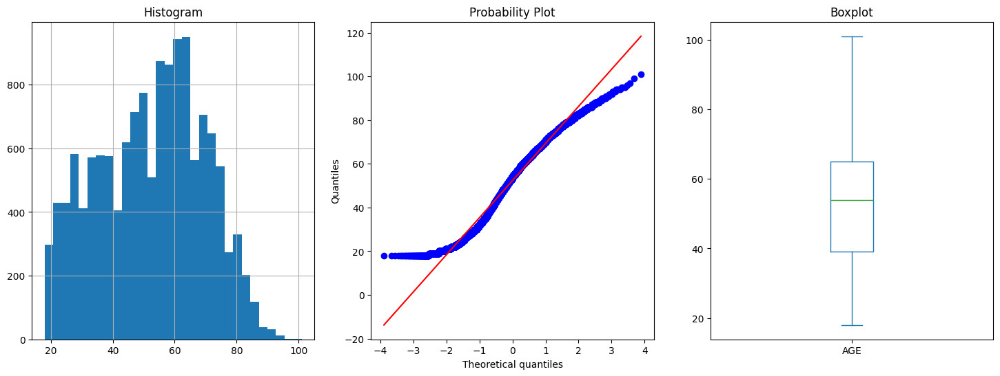

Feature name: RCRI score


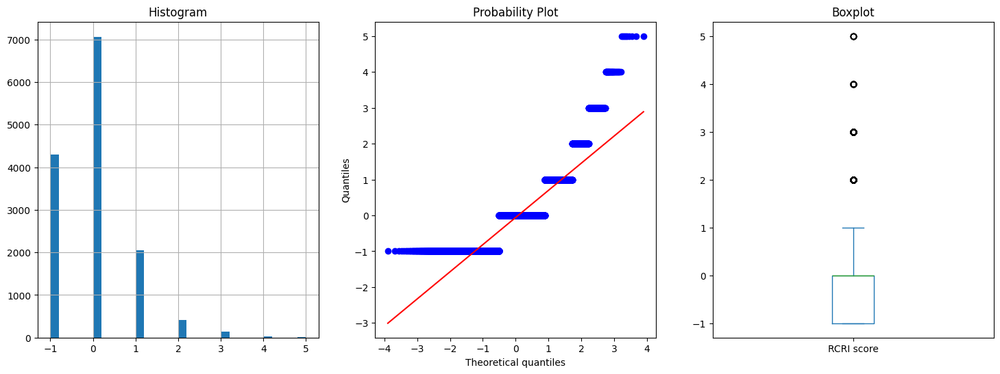

Feature name: PreopEGFRMDRD


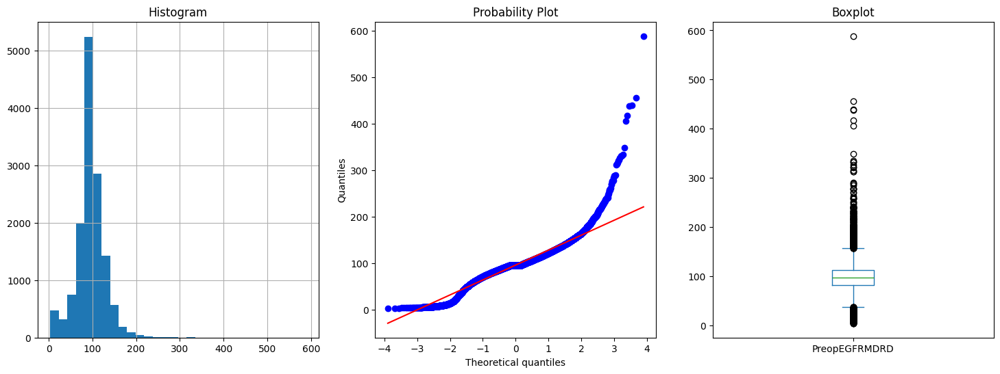

Feature name: Preoptransfusionwithin30days


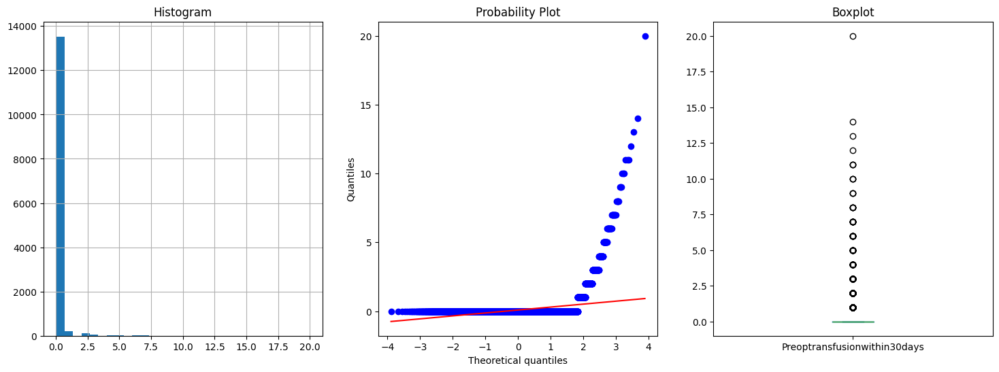

Feature name: Postopwithin30days


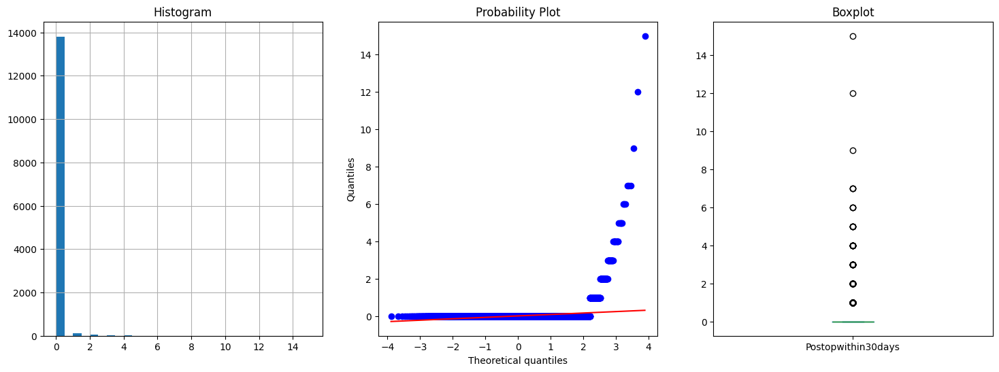

Feature name: Transfusionintraandpostop


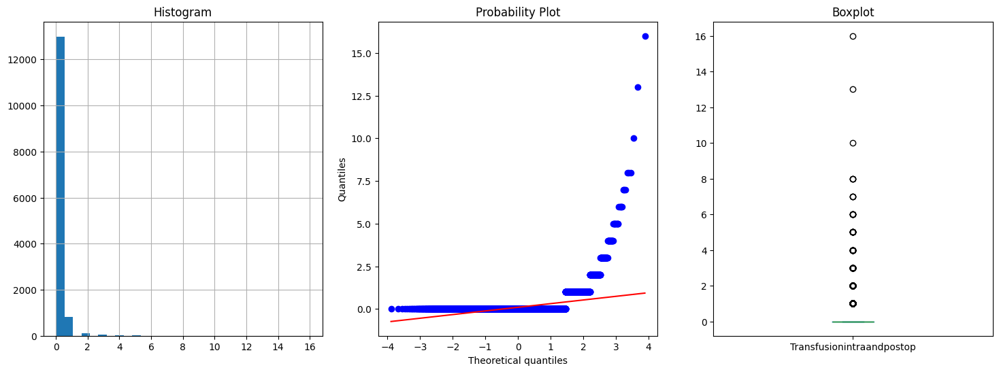

In [73]:
for col in numerical_columns:
    if len(imp_X_train[col].unique()) > 4:
        print ('Feature name:', col)
        diagnostic_plots(imp_X_train, col)

#### Transformation Station

In [74]:
numerical_columns

Index(['AGE', 'RCRI score', 'PreopEGFRMDRD', 'Preoptransfusionwithin30days',
       'Intraop', 'Postopwithin30days', 'Transfusionintraandpostop'],
      dtype='object')

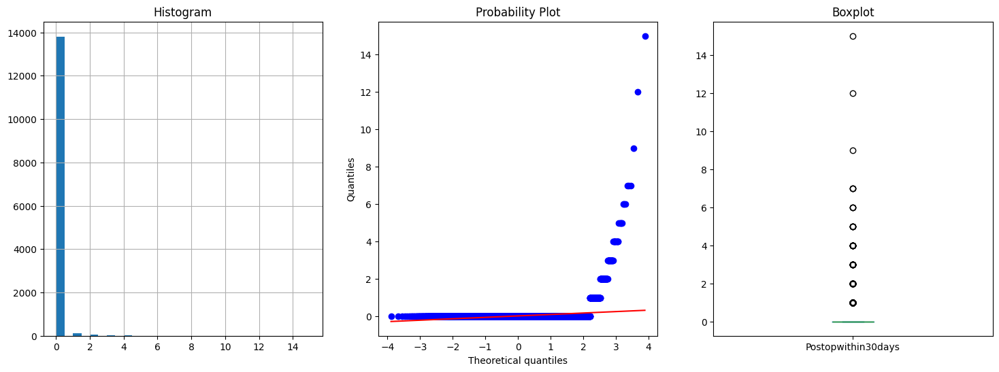

In [75]:
feature_name= 'Postopwithin30days'
# enter feature name

method= 'power'
# log (logarithm), rec (reciprocal), power (if set, please specify exp (power) level, else can ignore)
# yeo (yeo johnson), or box (boxcox)

exp= 1
# need to be set only if method is set to 'power'

# After you are done configuring the above, just run the cell. TIP: If you want to quickly view the
# original distribution, instead of scrolling up you can copy paste this cell and set to method= 'power', exp= 1

tmp_set= transformation_processor(imp_X_train, feature_name, method, exp)
diagnostic_plots(tmp_set, feature_name)

Density of PreopEGFRMDRD feature is very high, 0.5 power decided because explicit outlier handling techniques can be employed

Minimal impact of numerical feature transformation on the features Preoptransfusionwithin30days, Postopwithin30days and Transfusionintraandpostop

#### Numerical Feature Transformer Pipeline

In [76]:
numeric_trans_pipe= Pipeline(steps= [
    ('power0.5 transformation', PowerTransformer(variables= ['AGE', 'PreopEGFRMDRD'], exp= 0.5)),
    ('Yeo transformation', YeoJohnsonTransformer(variables= ['RCRI score'])),
])
numeric_trans_pipe.fit(imp_X_train)

Pipeline(steps=[('power0.5 transformation',
                 PowerTransformer(variables=['AGE', 'PreopEGFRMDRD'])),
                ('Yeo transformation',
                 YeoJohnsonTransformer(variables=['RCRI score']))])

In [77]:
trans_X_train= numeric_trans_pipe.transform(imp_X_train)
trans_X_test=  numeric_trans_pipe.transform(imp_X_test)

#### After Numerical Transformation

Feature name: AGE


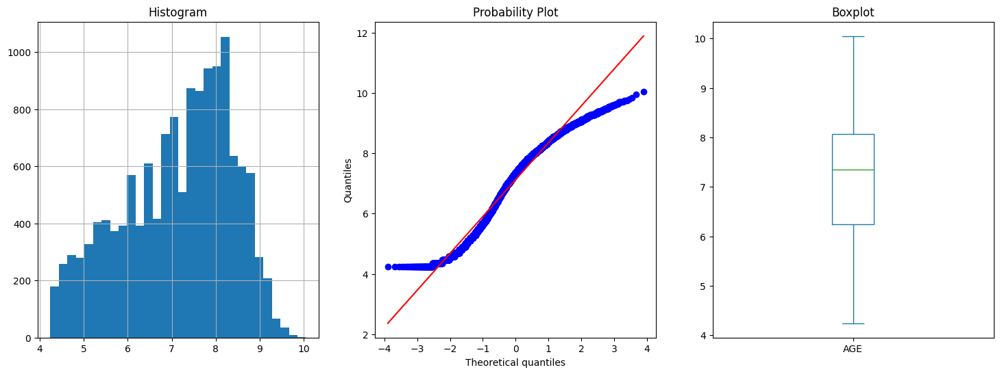

Feature name: RCRI score


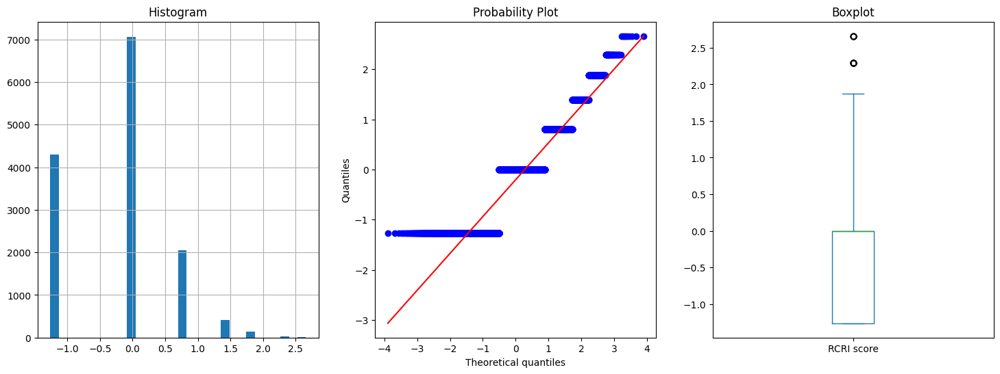

Feature name: PreopEGFRMDRD


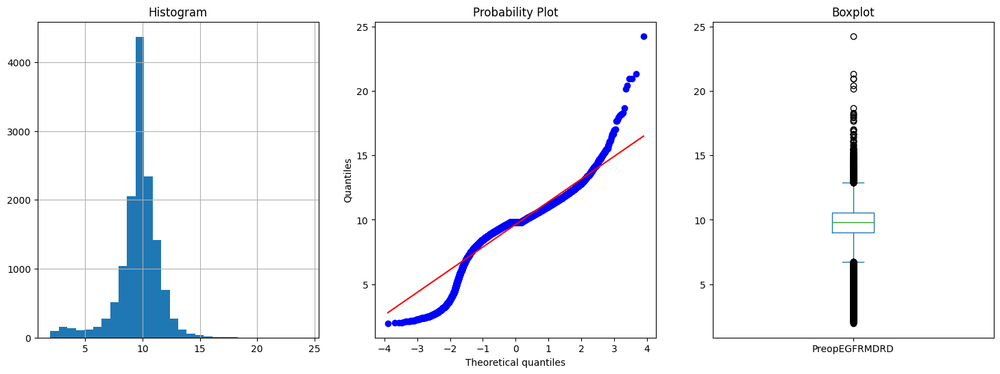

Feature name: Preoptransfusionwithin30days


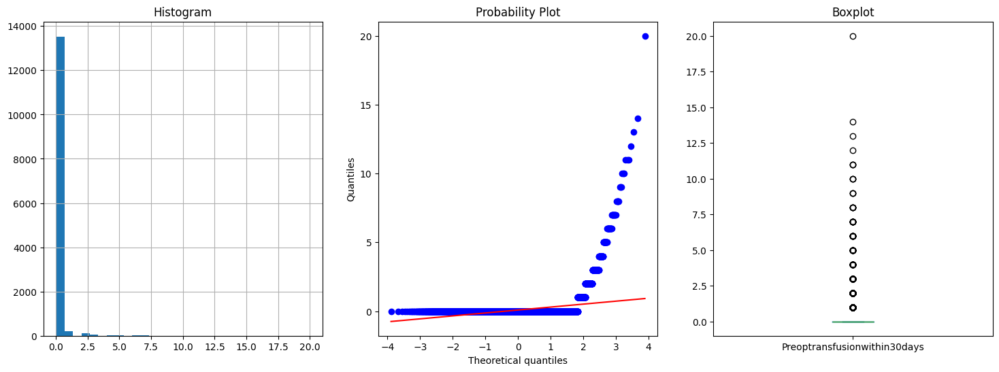

Feature name: Postopwithin30days


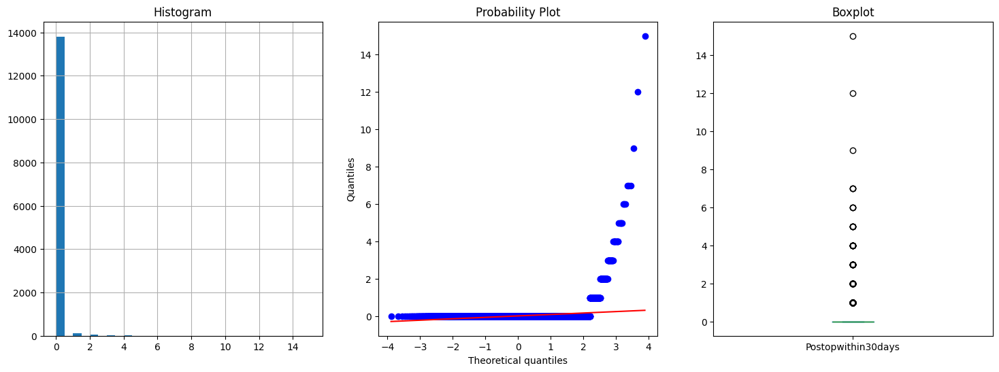

Feature name: Transfusionintraandpostop


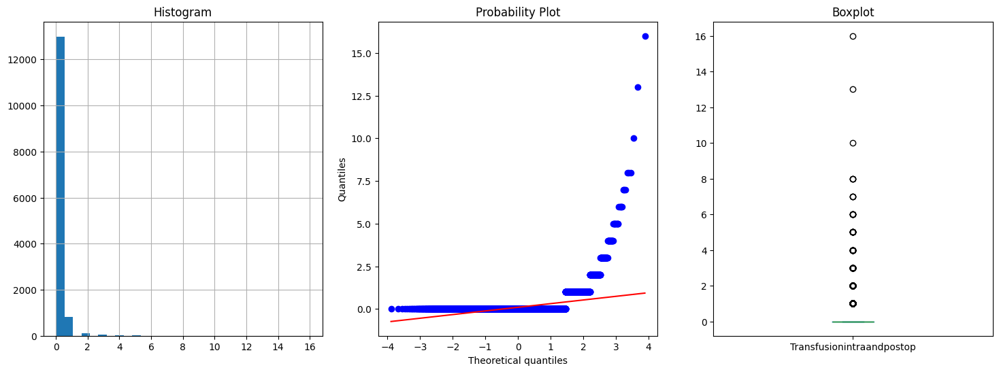

In [78]:
for col in numerical_columns:
    if len(trans_X_train[col].unique()) > 4:
        print ('Feature name:', col)
        diagnostic_plots(trans_X_train, col)

# Outlier Handling

In [79]:
# code to detect outliers

In [80]:
# code to inspect outliers for handling technique

In [81]:
# code to transform and remove outliers

In [82]:
# code to inspect changes to dataframe
# (If we actually decide on outlier handling, change the code in the next section to reflect the new name representing
# the cleaned dataframe with no outliers)

# Categorical Feature Encoding

In [83]:
categorical_features= trans_X_train.columns[trans_X_train.dtypes == 'object']
categorical_features

Index(['GENDER', 'Anemia category', 'GradeofKidneydisease',
       'AnaestypeCategory', 'PriorityCategory',
       'TransfusionIntraandpostopCategory', 'AGEcategory',
       'AGEcategoryOriginal', 'SurgRiskCategory', 'RaceCategory',
       'CVARCRICategory', 'IHDRCRICategory', 'CHFRCRICategory',
       'DMinsulinRCRICategory', 'CreatinineRCRICategory',
       'GradeofKidneyCategory', 'Anemiacategorybinned', 'RDW15.7',
       'ASAcategorybinned'],
      dtype='object')

In [84]:
for feature in categorical_features:
    print (trans_X_train[feature].value_counts())
    print ('Number of unique values in feature:', len(trans_X_train[feature].unique()))
    print () # buffer

GENDER
FEMALE    7429
MALE      6568
Name: count, dtype: int64
Number of unique values in feature: 2

Anemia category
none        9551
mild        1998
moderate    1692
#NULL!       661
severe        95
Name: count, dtype: int64
Number of unique values in feature: 5

GradeofKidneydisease
g1       7342
G2       3537
BLANK    1719
G3a       556
G5        333
G3b       270
G4        240
Name: count, dtype: int64
Number of unique values in feature: 7

AnaestypeCategory
GA    11946
RA     2051
Name: count, dtype: int64
Number of unique values in feature: 2

PriorityCategory
Elective     10930
Emergency     3067
Name: count, dtype: int64
Number of unique values in feature: 2

TransfusionIntraandpostopCategory
0 units            12991
1 unit               816
2 or more units      190
Name: count, dtype: int64
Number of unique values in feature: 3

AGEcategory
50-64    4329
30-49    4155
65-74    2414
18-29    1737
75-84    1156
>=85      206
Name: count, dtype: int64
Number of unique values i

In [85]:
enc_pipe= Pipeline(steps= [
    ('Dummy Encoder', OneHotEncoder(variables= ['GENDER', 'AnaestypeCategory', 'PriorityCategory', 'RaceCategory',
                                               'CVARCRICategory', 'IHDRCRICategory', 'CHFRCRICategory',
                                               'DMinsulinRCRICategory', 'CreatinineRCRICategory',
                                               'RDW15.7'], drop_last= True)),
    ('Ordinal Encoder', OrdinalEncoder(variables= ['Anemia category', 'GradeofKidneydisease', 'TransfusionIntraandpostopCategory',
                                                  'AGEcategory', 'AGEcategoryOriginal', 'SurgRiskCategory',
                                                  'GradeofKidneyCategory', 'Anemiacategorybinned', 'ASAcategorybinned'],
                                       encoding_method= 'arbitrary'))
])

enc_pipe.fit(trans_X_train)

Pipeline(steps=[('Dummy Encoder',
                 OneHotEncoder(drop_last=True,
                               variables=['GENDER', 'AnaestypeCategory',
                                          'PriorityCategory', 'RaceCategory',
                                          'CVARCRICategory', 'IHDRCRICategory',
                                          'CHFRCRICategory',
                                          'DMinsulinRCRICategory',
                                          'CreatinineRCRICategory',
                                          'RDW15.7'])),
                ('Ordinal Encoder',
                 OrdinalEncoder(encoding_method='arbitrary',
                                variables=['Anemia category',
                                           'GradeofKidneydisease',
                                           'TransfusionIntraandpostopCategory',
                                           'AGEcategory', 'AGEcategoryOriginal',
                                           'SurgRiskCategory',
                                           'GradeofKidneyCategory',
                                           'Anemiacategorybinned',
                                           'ASAcategorybinned']))])

In [88]:
enc_pipe[1].encoder_dict_= {'Anemia category': {'#NULL!': 0,
                                  'none': 1,
                                  'mild': 2,
                                  'moderate': 3,
                                  'severe': 4},
                                 'GradeofKidneydisease': {'BLANK': 0,
                                  'g1': 1,
                                  'G2': 2,
                                  'G3a': 3,
                                  'G3b': 4,
                                  'G4': 5,
                                  'G5': 6},
                                 'TransfusionIntraandpostopCategory': {'0 units': 0,
                                  '1 unit': 1,
                                  '2 or more units': 2},
                                'AGEcategory': {'18-29': 0,
                                  '30-49': 1,
                                  '50-64': 2,
                                  '65-74': 3,
                                  '75-84': 4,
                                  '>=85': 5},
                                'AGEcategoryOriginal': {'18-29': 0, '30-49': 1, '50-69': 2, '>=70': 3},
                                'SurgRiskCategory': {'Low': 0, 'Moderate': 1, 'High': 2},
                                'GradeofKidneyCategory': {'#NULL!': 0, 'G1': 1, 'G2': 2, 'G3': 3, 'G4-G5': 4},
                                'Anemiacategorybinned': {'#NULL!': 0,
                                  'none': 1,
                                  'Mild': 2,
                                  'Moderate/Severe': 3},
                                'ASAcategorybinned': {'#NULL!': 0, 'I': 1, 'II': 2, 'III': 3, 'IV-VI': 4}
                               }

enc_pipe[1].encoder_dict_

{'Anemia category': {'#NULL!': 0,
  'none': 1,
  'mild': 2,
  'moderate': 3,
  'severe': 4},
 'GradeofKidneydisease': {'BLANK': 0,
  'g1': 1,
  'G2': 2,
  'G3a': 3,
  'G3b': 4,
  'G4': 5,
  'G5': 6},
 'TransfusionIntraandpostopCategory': {'0 units': 0,
  '1 unit': 1,
  '2 or more units': 2},
 'AGEcategory': {'18-29': 0,
  '30-49': 1,
  '50-64': 2,
  '65-74': 3,
  '75-84': 4,
  '>=85': 5},
 'AGEcategoryOriginal': {'18-29': 0, '30-49': 1, '50-69': 2, '>=70': 3},
 'SurgRiskCategory': {'Low': 0, 'Moderate': 1, 'High': 2},
 'GradeofKidneyCategory': {'#NULL!': 0, 'G1': 1, 'G2': 2, 'G3': 3, 'G4-G5': 4},
 'Anemiacategorybinned': {'#NULL!': 0,
  'none': 1,
  'Mild': 2,
  'Moderate/Severe': 3},
 'ASAcategorybinned': {'#NULL!': 0, 'I': 1, 'II': 2, 'III': 3, 'IV-VI': 4}}

In [89]:
enc_X_train= enc_pipe.transform(trans_X_train)
enc_X_test=  enc_pipe.transform(trans_X_test)

In [90]:
display(enc_X_train.head(5))

,AGE,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,GradeofKidneyCategory,Anemiacategorybinned,ASAcategorybinned,GENDER_FEMALE,AnaestypeCategory_RA,PriorityCategory_Elective,RaceCategory_Chinese,RaceCategory_Others,RaceCategory_Malay,CVARCRICategory_no,IHDRCRICategory_no,CHFRCRICategory_no,DMinsulinRCRICategory_no,CreatinineRCRICategory_no,RDW15.7_>15.7,RDW15.7_<= 15.7
19977,9.848858,0.80324,3,10.258842,1,0,1,0,1,1,5,3,1,1,3,2,1,1,1,1,0,0,1,1,1,1,1,1,0
10779,8.000000,0.00000,1,9.280434,2,0,0,0,0,0,2,2,1,2,1,2,1,1,1,1,0,0,1,1,1,1,1,0,1
17224,8.306624,0.00000,1,13.101247,1,0,0,0,0,0,3,2,1,1,1,2,0,0,1,1,0,0,1,1,1,1,1,0,1
7369,6.557439,0.00000,1,10.127045,1,0,0,0,0,0,1,1,0,1,1,1,1,0,1,1,0,0,1,1,1,1,1,0,1
16330,8.306624,0.00000,1,7.991251,2,0,0,0,0,0,3,2,1,2,1,2,0,0,1,1,0,0,1,1,1,1,1,0,1


In [91]:
display(enc_X_test.head(5))

,AGE,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,GradeofKidneyCategory,Anemiacategorybinned,ASAcategorybinned,GENDER_FEMALE,AnaestypeCategory_RA,PriorityCategory_Elective,RaceCategory_Chinese,RaceCategory_Others,RaceCategory_Malay,CVARCRICategory_no,IHDRCRICategory_no,CHFRCRICategory_no,DMinsulinRCRICategory_no,CreatinineRCRICategory_no,RDW15.7_>15.7,RDW15.7_<= 15.7
10747,7.348469,0.000000,2,12.090110,1,0,0,0,0,0,2,2,0,1,2,3,0,0,1,1,0,0,1,1,1,1,1,1,0
4949,6.403124,0.000000,1,9.635022,1,0,0,0,0,0,1,1,0,1,1,2,0,0,1,0,0,0,1,1,1,1,1,0,1
3352,5.567764,-1.261682,1,10.922201,1,0,1,0,1,1,1,1,1,1,1,0,0,0,0,1,0,0,1,1,1,1,1,0,1
3125,5.916080,-1.261682,2,9.858900,1,0,0,0,0,0,1,1,0,1,2,1,0,0,1,0,1,0,1,1,1,1,1,0,1
17925,8.485281,-1.261682,2,8.424996,2,0,0,0,0,0,3,3,1,2,2,3,0,0,1,1,0,0,1,1,1,1,1,0,1


# Feature Engineering

In [92]:
eng_X_train= enc_X_train
eng_X_test=  enc_X_test

# Feature Scaling

In [93]:
scaler= StandardScaler()

In [94]:
scaler.fit(eng_X_train)

StandardScaler()

In [95]:
scaled_X_train= pd.DataFrame(scaler.transform(eng_X_train), columns= eng_X_train.columns)
scaled_X_test=  pd.DataFrame(scaler.transform(eng_X_test), columns= eng_X_test.columns) 

In [96]:
fig= make_subplots(rows= 1, cols= 2)

for column in [c for c in eng_X_train.columns if eng_X_train[c].dtype != "O"]:
    density= stats.gaussian_kde(eng_X_train[column])
    xs= np.linspace(min(eng_X_train[column]), max(eng_X_train[column]), 200)
    fig.add_trace(go.Scatter(x= xs, y= density(xs), mode= 'lines', name= column), row= 1, col= 1)

for column in [c for c in scaled_X_train.columns if scaled_X_train[c].dtype != "O"]:
    density= stats.gaussian_kde(scaled_X_train[column])
    xs= np.linspace(min(scaled_X_train[column]), max(scaled_X_train[column]), 200)
    fig.add_trace(go.Scatter(x= xs, y= density(xs), mode= 'lines', name= column), row= 1, col= 2)
    
fig.update_xaxes(title_text= "Value", row= 1, col= 1)
fig.update_yaxes(title_text= "Density", row= 1, col= 1)
fig.update_xaxes(title_text= "Value", row= 1, col= 2)
fig.update_yaxes(title_text= "Density", row= 1, col= 2)
fig.update_layout(title_text= "Before Scaling vs. After Scaling", bargap= 0.2)

fig.show(renderer= 'notebook')

In [98]:
display(scaled_X_train.head(5))

,AGE,RCRI score,Anemia category,PreopEGFRMDRD,GradeofKidneydisease,Preoptransfusionwithin30days,Intraop,Postopwithin30days,Transfusionintraandpostop,TransfusionIntraandpostopCategory,AGEcategory,AGEcategoryOriginal,SurgRiskCategory,GradeofKidneyCategory,Anemiacategorybinned,ASAcategorybinned,GENDER_FEMALE,AnaestypeCategory_RA,PriorityCategory_Elective,RaceCategory_Chinese,RaceCategory_Others,RaceCategory_Malay,CVARCRICategory_no,IHDRCRICategory_no,CHFRCRICategory_no,DMinsulinRCRICategory_no,CreatinineRCRICategory_no,RDW15.7_>15.7,RDW15.7_<= 15.7
0,2.190654,1.246705,2.108573,0.330585,-0.388463,-0.138412,3.595464,-0.085791,1.934723,2.818424,2.671650,1.509047,0.757698,-0.403876,2.17002,0.184786,0.940267,2.413395,0.529721,0.633658,-0.334562,-0.330189,0.139717,0.220503,0.102312,0.154422,0.167953,3.045784,-2.211559
1,0.703824,0.251135,-0.459175,-0.194872,0.465790,-0.138412,-0.278128,-0.085791,-0.212464,-0.263326,0.137879,0.409509,0.757698,0.685554,-0.46168,0.184786,0.940267,2.413395,0.529721,0.633658,-0.334562,-0.330189,0.139717,0.220503,0.102312,0.154422,0.167953,-0.328323,0.452170
2,0.950408,0.251135,-0.459175,1.857106,-0.388463,-0.138412,-0.278128,-0.085791,-0.212464,-0.263326,0.982469,0.409509,0.757698,-0.403876,-0.46168,0.184786,-1.063527,-0.414354,0.529721,0.633658,-0.334562,-0.330189,0.139717,0.220503,0.102312,0.154422,0.167953,-0.328323,0.452170
3,-0.456267,0.251135,-0.459175,0.259803,-0.388463,-0.138412,-0.278128,-0.085791,-0.212464,-0.263326,-0.706712,-0.690030,-0.901745,-0.403876,-0.46168,-1.022141,0.940267,-0.414354,0.529721,0.633658,-0.334562,-0.330189,0.139717,0.220503,0.102312,0.154422,0.167953,-0.328323,0.452170
4,0.950408,0.251135,-0.459175,-0.887231,0.465790,-0.138412,-0.278128,-0.085791,-0.212464,-0.263326,0.982469,0.409509,0.757698,0.685554,-0.46168,0.184786,-1.063527,-0.414354,0.529721,0.633658,-0.334562,-0.330189,0.139717,0.220503,0.102312,0.154422,0.167953,-0.328323,0.452170


# Machine Learning Modelling

Recall measures the ratio of correctly predicted classes against the actual total number in that class.

Precision measures the ratio of correctly predicted classes against the total number of predictions made by the model for that class

Optimizing for recall often leads to lower Precision metric scores and vice versa. F1 score is a good mix of measure of recall and precision as a single numerical score.

In [145]:
selected_features= scaled_X_train.columns
# for feature selection if any, else .columns to extract all columns and set as input X features

selected_X_train= scaled_X_train[selected_features]
selected_X_test = scaled_X_test[selected_features]

### Logistics Regression Model

##### For ICUAdmgt24h Target Variable

###### Baseline Model

In [300]:
lg_ICU= LogisticRegression(random_state= random_state)

In [301]:
lg_ICU.fit(selected_X_train, y_train['ICUAdmgt24h'])

LogisticRegression(random_state=42)

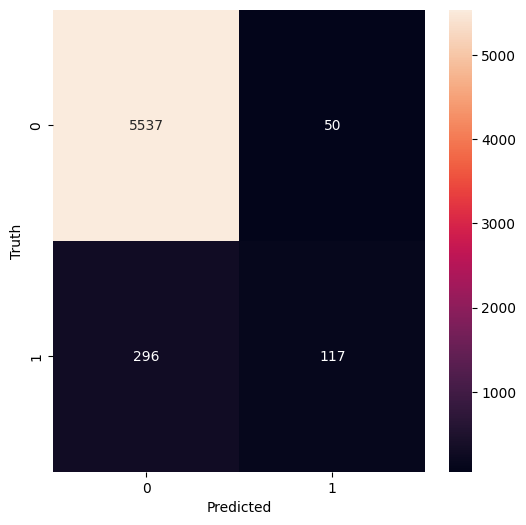

In [302]:
y_true= y_test['ICUAdmgt24h']
y_pred= lg_ICU.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [303]:
report= classification_report(y_test['ICUAdmgt24h'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.95      0.99      0.97      5587
           1       0.70      0.28      0.40       413

    accuracy                           0.94      6000
   macro avg       0.82      0.64      0.69      6000
weighted avg       0.93      0.94      0.93      6000



###### Tuning Parameter Values

##### For @30daymortality Target Variable

###### Baseline Model

In [304]:
lg_mortality= LogisticRegression(random_state= random_state)

In [305]:
lg_mortality.fit(selected_X_train, y_train['@30daymortality'])

LogisticRegression(random_state=42)

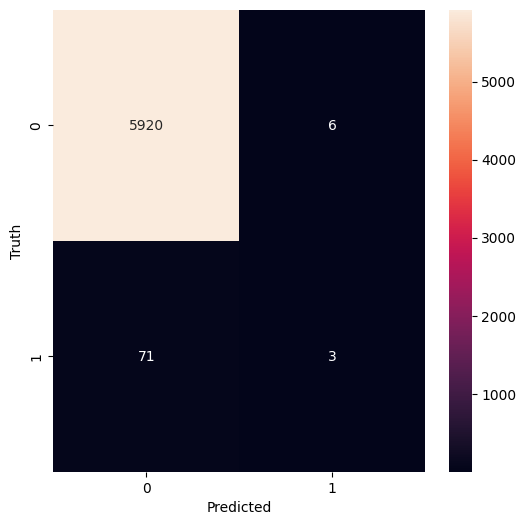

In [307]:
y_true= y_test['@30daymortality']
y_pred= lg_mortality.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [308]:
report= classification_report(y_test['@30daymortality'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      5926
           1       0.33      0.04      0.07        74

    accuracy                           0.99      6000
   macro avg       0.66      0.52      0.53      6000
weighted avg       0.98      0.99      0.98      6000



###### Tuning Parameter Values

### Random Forest Classifier Model

##### For ICUAdmgt24h Target Variable

###### Baseline Model

In [290]:
rand_forest_ICU= RandomForestClassifier(random_state= random_state)

In [291]:
rand_forest_ICU.fit(selected_X_train, y_train['ICUAdmgt24h'])

RandomForestClassifier(random_state=42)

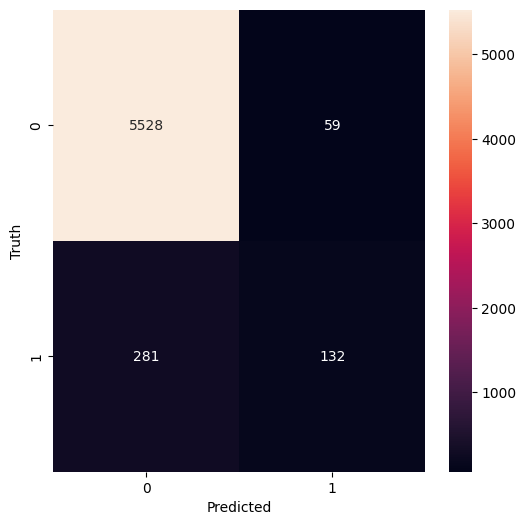

In [292]:
y_true= y_test['ICUAdmgt24h']
y_pred= rand_forest_ICU.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [293]:
report= classification_report(y_test['ICUAdmgt24h'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.95      0.99      0.97      5587
           1       0.69      0.32      0.44       413

    accuracy                           0.94      6000
   macro avg       0.82      0.65      0.70      6000
weighted avg       0.93      0.94      0.93      6000



###### Tuning Parameter Values

In [310]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= 'ICUAdmgt24h'
param_values= [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= RandomForestClassifier(random_state= random_state, n_estimators= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 10 | Precision : 0.6510067114093959 | recall : 0.23486682808716708 | f1 : 0.34519572953736655 | roc_auc : 0.8515000015168385
Param Value : 20 | Precision : 0.7034482758620689 | recall : 0.2469733656174334 | f1 : 0.3655913978494624 | roc_auc : 0.8728141816591699
Param Value : 30 | Precision : 0.7115384615384616 | recall : 0.2687651331719128 | f1 : 0.39015817223198596 | roc_auc : 0.8860984358795561
Param Value : 40 | Precision : 0.7375 | recall : 0.2857142857142857 | f1 : 0.4118673647469459 | roc_auc : 0.8931686364619353
Param Value : 50 | Precision : 0.7169811320754716 | recall : 0.27602905569007263 | f1 : 0.3986013986013986 | roc_auc : 0.8974385366236303
Param Value : 60 | Precision : 0.7032258064516129 | recall : 0.2639225181598063 | f1 : 0.38380281690140844 | roc_auc : 0.8993319843583621
Param Value : 70 | Precision : 0.7161290322580646 | recall : 0.2687651331719128 | f1 : 0.3908450704225352 | roc_auc : 0.8997523652928301
Param Value : 80 | Prec

In [311]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against n_estimators parameter')
fig.show()

##### For @30daymortality Target Variable

###### Baseline Model

In [295]:
rand_forest_mortality= RandomForestClassifier(random_state= random_state)

In [296]:
rand_forest_mortality.fit(selected_X_train, y_train['@30daymortality'])

RandomForestClassifier(random_state=42)

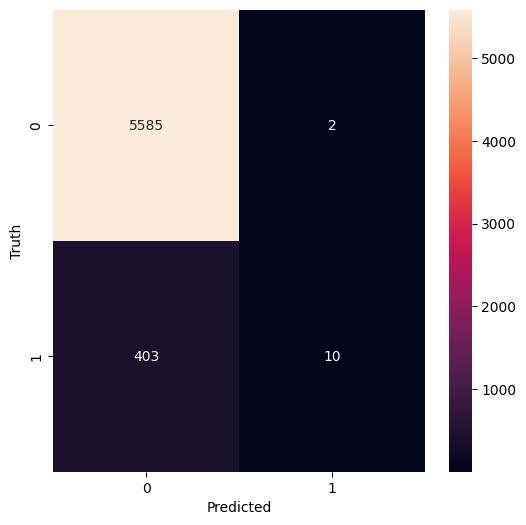

In [297]:
y_true= y_test['ICUAdmgt24h']
y_pred= rand_forest_mortality.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [299]:
report= classification_report(y_test['@30daymortality'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      5926
           1       0.50      0.08      0.14        74

    accuracy                           0.99      6000
   macro avg       0.74      0.54      0.57      6000
weighted avg       0.98      0.99      0.98      6000



###### Tuning Parameter Values

### Gradient Boosting Classifier Model

##### For ICUAdmgt24h Target Variable

###### Baseline Gradient Boosting Classifier Model Baseline

In [286]:
gbc_ICU= GradientBoostingClassifier(random_state= random_state)

In [287]:
gbc_ICU.fit(selected_X_train, y_train['ICUAdmgt24h'])

GradientBoostingClassifier(random_state=42)

In [288]:
y_pred= gbc_ICU.predict(selected_X_test)
report= classification_report(y_test['ICUAdmgt24h'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.95      0.99      0.97      5587
           1       0.70      0.37      0.48       413

    accuracy                           0.95      6000
   macro avg       0.83      0.68      0.73      6000
weighted avg       0.94      0.95      0.94      6000



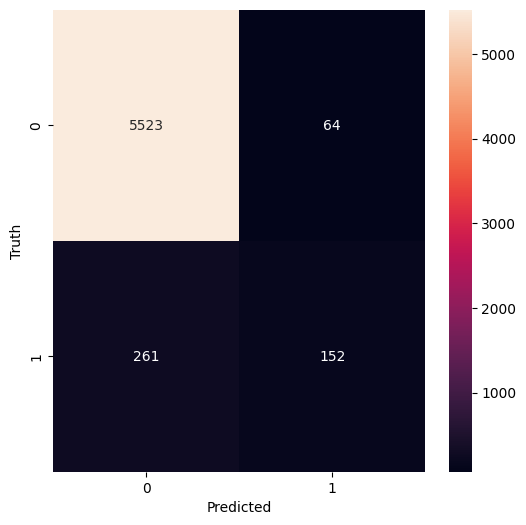

In [289]:
y_true= y_test['ICUAdmgt24h']
y_pred= gbc_ICU.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

###### Tuning Parameter Values

In [186]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= 'ICUAdmgt24h'
param_values= [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 10 | Precision : 0.2667185069984448 | recall : 0.8305084745762712 | f1 : 0.403766921718658 | roc_auc : 0.9006852209231825
Param Value : 20 | Precision : 0.3008695652173913 | recall : 0.837772397094431 | f1 : 0.44273832373640437 | roc_auc : 0.9086960780192345
Param Value : 30 | Precision : 0.31043710972346117 | recall : 0.8426150121065376 | f1 : 0.45371577574967403 | roc_auc : 0.91196183114468
Param Value : 40 | Precision : 0.31689497716894977 | recall : 0.8401937046004843 | f1 : 0.46021220159151194 | roc_auc : 0.9136416213529245
Param Value : 50 | Precision : 0.3215613382899628 | recall : 0.837772397094431 | f1 : 0.46474143720617866 | roc_auc : 0.9152629049362689
Param Value : 60 | Precision : 0.324577861163227 | recall : 0.837772397094431 | f1 : 0.4678837052062204 | roc_auc : 0.9164813595726156
Param Value : 70 | Precision : 0.32950191570881227 | recall : 0.8329297820823245 | f1 : 0.4722031571722718 | roc_auc : 0.9173028359244546
Param Value : 80

In [187]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against n_estimators parameter')
fig.show()

In [181]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= 'ICUAdmgt24h'
param_values= [0.05, 0.075, 0.1, 0.125, 0.150]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= 40, learning_rate= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 0.05 | Precision : 0.30113141862489123 | recall : 0.837772397094431 | f1 : 0.44302176696542894 | roc_auc : 0.9094778998808632
Param Value : 0.075 | Precision : 0.3114901256732496 | recall : 0.8401937046004843 | f1 : 0.4544859201047806 | roc_auc : 0.912205175366024
Param Value : 0.1 | Precision : 0.31689497716894977 | recall : 0.8401937046004843 | f1 : 0.46021220159151194 | roc_auc : 0.9136416213529245
Param Value : 0.125 | Precision : 0.3186409550045914 | recall : 0.8401937046004843 | f1 : 0.4620505992010652 | roc_auc : 0.915410905028146
Param Value : 0.15 | Precision : 0.3211267605633803 | recall : 0.8280871670702179 | f1 : 0.462787550744249 | roc_auc : 0.9166863494509696
##### END OF TRAINING LOG #####


In [183]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against learning_rate parameter')
fig.show()

In [199]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= 'ICUAdmgt24h'
param_values= ['friedman_mse', 'squared_error']

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= 40, learning_rate= 0.125, criterion= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : friedman_mse | Precision : 0.3186409550045914 | recall : 0.8401937046004843 | f1 : 0.4620505992010652 | roc_auc : 0.915410905028146
Param Value : squared_error | Precision : 0.3186409550045914 | recall : 0.8401937046004843 | f1 : 0.4620505992010652 | roc_auc : 0.9154031041448261
##### END OF TRAINING LOG #####


In [200]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.bar(data_extract, x= 'Parameter Value', y= 'Recall Scores', text_auto= True)
fig.update_layout(title= 'Recall Score Against criterion parameter')
fig.show()

In [196]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= 'ICUAdmgt24h'
param_values= [(i+1)/20 for i in range(20)]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= 40, learning_rate= 0.125, criterion= 'friedman_mse',
                                     subsample= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 0.05 | Precision : 0.3458149779735683 | recall : 0.7602905569007264 | f1 : 0.4753974261922786 | roc_auc : 0.9062110632994009
Param Value : 0.1 | Precision : 0.3415384615384615 | recall : 0.8062953995157385 | f1 : 0.47982708933717577 | roc_auc : 0.911732788542756
Param Value : 0.15 | Precision : 0.3375984251968504 | recall : 0.8305084745762712 | f1 : 0.4800559832050385 | roc_auc : 0.9153183778843226
Param Value : 0.2 | Precision : 0.32855778414517667 | recall : 0.8329297820823245 | f1 : 0.4712328767123288 | roc_auc : 0.9143629863688231
Param Value : 0.25 | Precision : 0.31890874882408277 | recall : 0.8208232445520581 | f1 : 0.45934959349593496 | roc_auc : 0.911414252473855
Param Value : 0.3 | Precision : 0.3269961977186312 | recall : 0.8329297820823245 | f1 : 0.4696245733788396 | roc_auc : 0.9146292998577205
Param Value : 0.35 | Precision : 0.32608695652173914 | recall : 0.8353510895883777 | f1 : 0.469068660774983 | roc_auc : 0.9162919714609017
Par

In [198]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against subsample parameter')
fig.show()

##### Final Evaluation of Gradient Boosting Model Performance for ICUAdmgt24h Target Variable
<br>
(Given the best machine learning parameter values)

In [246]:
final_gbc_ICU= GradientBoostingClassifier(random_state= random_state, n_estimators= 40, learning_rate= 0.125, criterion= 'friedman_mse',
                                     subsample= 0.95)
final_gbc_ICU.fit(selected_X_train, y_train['ICUAdmgt24h'], sample_weight= class_weights)

GradientBoostingClassifier(learning_rate=0.125, n_estimators=40,
                           random_state=42, subsample=0.95)

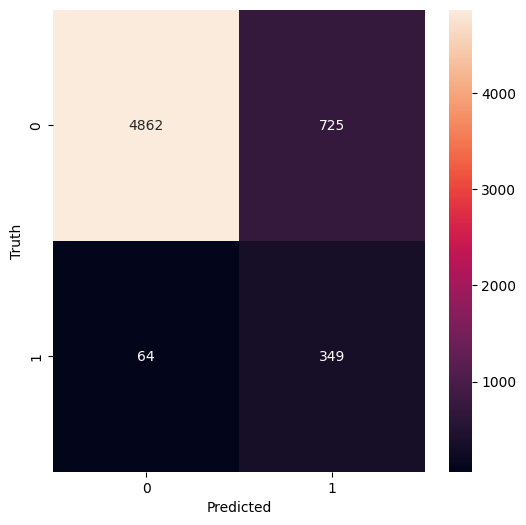

In [247]:
y_true= y_test['ICUAdmgt24h']
y_pred= final_gbc_ICU.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [248]:
y_pred= final_gbc_ICU.predict(selected_X_test)
report= classification_report(y_test['ICUAdmgt24h'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.99      0.87      0.92      5587
           1       0.32      0.85      0.47       413

    accuracy                           0.87      6000
   macro avg       0.66      0.86      0.70      6000
weighted avg       0.94      0.87      0.89      6000



##### For @30daymortality Target Variable

###### Gradient Boosting Classifier Baseline Model

In [282]:
gbc_mortality= GradientBoostingClassifier(random_state= random_state)

In [283]:
gbc_mortality.fit(selected_X_train, y_train['@30daymortality'])

GradientBoostingClassifier(random_state=42)

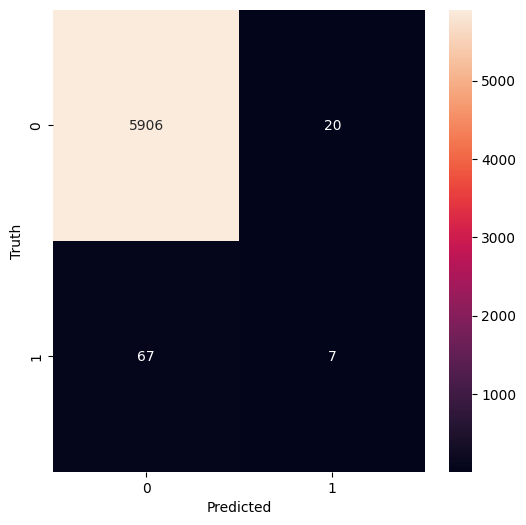

In [284]:
y_true= y_test['@30daymortality']
y_pred= gbc_mortality.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [285]:
y_pred= gbc_mortality.predict(selected_X_test)
report= classification_report(y_test['@30daymortality'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      5926
           1       0.26      0.09      0.14        74

    accuracy                           0.99      6000
   macro avg       0.62      0.55      0.57      6000
weighted avg       0.98      0.99      0.98      6000



###### Tuning Parameter Values

In [253]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= '@30daymortality'
param_values= [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 10 | Precision : 0.0628385698808234 | recall : 0.7837837837837838 | f1 : 0.11634904714142427 | roc_auc : 0.8950775784221616
Param Value : 20 | Precision : 0.06791569086651054 | recall : 0.7837837837837838 | f1 : 0.125 | roc_auc : 0.9160239804434875
Param Value : 30 | Precision : 0.07806191117092867 | recall : 0.7837837837837838 | f1 : 0.1419828641370869 | roc_auc : 0.9177650482071678
Param Value : 40 | Precision : 0.08309037900874636 | recall : 0.7702702702702703 | f1 : 0.15 | roc_auc : 0.9208675009805621
Param Value : 50 | Precision : 0.08503937007874016 | recall : 0.7297297297297297 | f1 : 0.152327221438646 | roc_auc : 0.9207648840200308
Param Value : 60 | Precision : 0.08717105263157894 | recall : 0.7162162162162162 | f1 : 0.15542521994134897 | roc_auc : 0.9195790880316699
Param Value : 70 | Precision : 0.09233449477351917 | recall : 0.7162162162162162 | f1 : 0.16358024691358025 | roc_auc : 0.9185757221953645
Param Value : 80 | Precision : 0.09

In [254]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against n_estimators parameter')
fig.show()

In [256]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= '@30daymortality'
param_values= [0.05, 0.075, 0.1, 0.125, 0.150]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= 30, learning_rate= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 0.05 | Precision : 0.06426155580608793 | recall : 0.7702702702702703 | f1 : 0.1186264308012487 | roc_auc : 0.9068933513331083
Param Value : 0.075 | Precision : 0.07257072570725707 | recall : 0.7972972972972973 | f1 : 0.133032694475761 | roc_auc : 0.9176042816356688
Param Value : 0.1 | Precision : 0.07806191117092867 | recall : 0.7837837837837838 | f1 : 0.1419828641370869 | roc_auc : 0.9177650482071678
Param Value : 0.125 | Precision : 0.08080808080808081 | recall : 0.7567567567567568 | f1 : 0.14602346805736635 | roc_auc : 0.9198538734482036
Param Value : 0.15 | Precision : 0.0880503144654088 | recall : 0.7567567567567568 | f1 : 0.15774647887323945 | roc_auc : 0.9198116864755407
##### END OF TRAINING LOG #####


In [257]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against learning_rate parameter')
fig.show()

In [262]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= '@30daymortality'
param_values= ['friedman_mse', 'squared_error']

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= 30, learning_rate= 0.075, criterion= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : friedman_mse | Precision : 0.07257072570725707 | recall : 0.7972972972972973 | f1 : 0.133032694475761 | roc_auc : 0.9176042816356688
Param Value : squared_error | Precision : 0.07257072570725707 | recall : 0.7972972972972973 | f1 : 0.133032694475761 | roc_auc : 0.9176042816356688
##### END OF TRAINING LOG #####


In [263]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.bar(data_extract, x= 'Parameter Value', y= 'Recall Scores', text_auto= True)
fig.update_layout(title= 'Recall Score Against criterion parameter')
fig.show()

In [264]:
recall_scores, precision_scores, f1_scores, roc_auc_scores= [], [], [], []
target_variable= '@30daymortality'
param_values= [(i+1)/20 for i in range(20)]

class_weights= class_weight.compute_sample_weight('balanced', y_train[target_variable])
class_weights

print ('##### TRAINING LOG #####')

for param_value in param_values:
    model= GradientBoostingClassifier(random_state= random_state, n_estimators= 30, learning_rate= 0.075, criterion= 'friedman_mse',
                                     subsample= param_value)
    model.fit(selected_X_train, y_train[target_variable], sample_weight= class_weights)
    y_pred= model.predict(selected_X_test)
    recall= recall_score(y_test[target_variable], y_pred)
    f1= f1_score(y_test[target_variable], y_pred)
    precision= precision_score(y_test[target_variable], y_pred)
    roc_auc= roc_auc_score(y_test[target_variable], model.predict_proba(selected_X_test)[:, 1])
    
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    roc_auc_scores.append(roc_auc)
    print (f'Param Value : {param_value} | Precision : {precision} | recall : {recall} | f1 : {f1} | roc_auc : {roc_auc}')
    
print ('##### END OF TRAINING LOG #####')

##### TRAINING LOG #####
Param Value : 0.05 | Precision : 0.12167300380228137 | recall : 0.43243243243243246 | f1 : 0.18991097922848665 | roc_auc : 0.8991446306245496
Param Value : 0.1 | Precision : 0.109375 | recall : 0.5675675675675675 | f1 : 0.18340611353711792 | roc_auc : 0.9031421313314665
Param Value : 0.15 | Precision : 0.0944206008583691 | recall : 0.5945945945945946 | f1 : 0.16296296296296298 | roc_auc : 0.9110960859610876
Param Value : 0.2 | Precision : 0.09352517985611511 | recall : 0.7027027027027027 | f1 : 0.16507936507936508 | roc_auc : 0.9084611104523355
Param Value : 0.25 | Precision : 0.09233449477351917 | recall : 0.7162162162162162 | f1 : 0.16358024691358025 | roc_auc : 0.918291815271228
Param Value : 0.3 | Precision : 0.08972267536704731 | recall : 0.7432432432432432 | f1 : 0.16011644832605532 | roc_auc : 0.9155245779022356
Param Value : 0.35 | Precision : 0.09136212624584718 | recall : 0.7432432432432432 | f1 : 0.16272189349112426 | roc_auc : 0.9160217000665871
Par

In [265]:
data_extract= {'Parameter Value': param_values, 'Recall Scores': recall_scores}

fig= px.line(data_extract, x= 'Parameter Value', y= 'Recall Scores')
fig.update_layout(title= 'Recall Score Against subsample parameter')
fig.show()

##### Final Evaluation of Gradient Boosting Model Performance for @30daymortality Target Variable
<br>
(Given the best machine learning parameter values)

In [268]:
final_gbc_mortality= GradientBoostingClassifier(random_state= random_state, n_estimators= 30, learning_rate= 0.075, criterion= 'friedman_mse',
                                     subsample= 1.0)
final_gbc_mortality.fit(selected_X_train, y_train['@30daymortality'], sample_weight= class_weights)

GradientBoostingClassifier(learning_rate=0.075, n_estimators=30,
                           random_state=42)

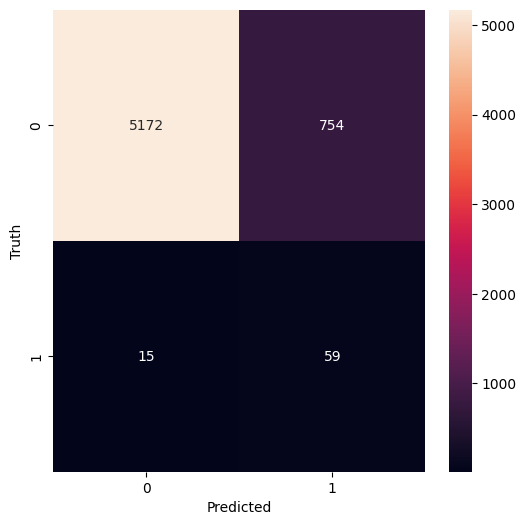

In [269]:
y_true= y_test['@30daymortality']
y_pred= final_gbc_mortality.predict(selected_X_test)

cm= confusion_matrix(y_true, y_pred)

plt.figure(figsize= (6, 6))
sns.heatmap(cm, annot= True, fmt= 'd')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [270]:
y_pred= final_gbc_mortality.predict(selected_X_test)
report= classification_report(y_test['@30daymortality'], y_pred)
print (report)

              precision    recall  f1-score   support

           0       1.00      0.87      0.93      5926
           1       0.07      0.80      0.13        74

    accuracy                           0.87      6000
   macro avg       0.53      0.84      0.53      6000
weighted avg       0.99      0.87      0.92      6000



# Final Model Comparison and Testing

##### For ICUAdmgt24h Target Variable

In [273]:
models_score= {'Gradient Boosting Classifier (ICU)': final_gbc_ICU, } #'Random Forest Classifier (ICU)': final_rand_forest_ICU,
              #'Logistic Regression (ICU)': final_lg_ICU}

fig= go.Figure()
for model_name, model in models_score.items():
    probs= model.predict_proba(selected_X_test)
    preds= probs[:, 1]
    fpr, tpr, threshold= metrics.roc_curve(y_test['ICUAdmgt24h'], preds)
    roc_auc= metrics.auc(fpr, tpr)
    
    fig.add_trace(go.Scatter(x= fpr, y= tpr, mode= 'lines', name= f'{model_name} (area = {roc_auc:.5f})'))
    
fig.add_trace(go.Scatter(x= [0, 1], y= [0, 1], mode= 'lines', name= 'Random (area = 0.5)', line= dict(dash= 'dash')))
fig.update_xaxes(range= [-0.005, 1.005])
fig.update_yaxes(range= [-0.005, 1.005])
fig.update_layout(title_text='Receiver Operating Characteristic across Multiple Trained Models (ICUAdmgt24h)',
    xaxis_title='False Positive Rate',
    yaxis_title='True Positive Rate',
    legend= dict(
        yanchor="top",
        y=-0.2,
        xanchor="center",
        x=0.5,
        orientation="h"
    )
)
fig.show()

In [ ]:
joblib(type_model_name_here, 'choose_name_here.pkl')

##### For @30daymortality Target Variable

In [ ]:
# Some analysis here

In [272]:
models_score= {'Gradient Boosting Classifier (30 day mortality)': final_gbc_mortality, }
              # 'Random Forest Classifier (30 day mortality)': final_rand_forest_mortality,
              #'Logistic Regression (30 day mortality)': final_lg_mortality}

fig= go.Figure()
for model_name, model in models_score.items():
    probs= model.predict_proba(selected_X_test)
    preds= probs[:, 1]
    fpr, tpr, threshold= metrics.roc_curve(y_test['ICUAdmgt24h'], preds)
    roc_auc= metrics.auc(fpr, tpr)
    
    fig.add_trace(go.Scatter(x= fpr, y= tpr, mode= 'lines', name= f'{model_name} (area = {roc_auc:.5f})'))
    
fig.add_trace(go.Scatter(x= [0, 1], y= [0, 1], mode= 'lines', name= 'Random (area = 0.5)', line= dict(dash= 'dash')))
fig.update_xaxes(range= [-0.005, 1.005])
fig.update_yaxes(range= [-0.005, 1.005])
fig.update_layout(title_text='Receiver Operating Characteristic across Multiple Trained Models (ICUAdmgt24h)',
    xaxis_title='False Positive Rate',
    yaxis_title='True Positive Rate',
    legend= dict(
        yanchor="top",
        y=-0.2,
        xanchor="center",
        x=0.5,
        orientation="h"
    )
)
fig.show()

In [314]:
joblib.dump(final_gbc_ICU, 'final_gbc_ICU.pkl')

['final_gbc_ICU.pkl']

In [316]:
# to load the model
final_gbc_ICU= joblib.load('final_gbc_ICU.pkl')

# Deployment and Input Code

<br>